# Cat and Dog Image classification

This dataset was taken from a Kaggle competition for pet adoption rate prediction. The dataset has 10331 training images and meta data in other files related to each pet.<br>
<br>In this notebook I will begin by analysing the meta data of the pets and comparing the distibution of the pets. I want to be able to classify whether an image is a cat or a dog, but the image names arent labeled to tell you what type they are. <br><br>The image name is made of the PetId and the number of the image (1 is the pets profile picture). This will require some feature engineering to match each pet with their respective picture. 

Dog | Cat
- | - 
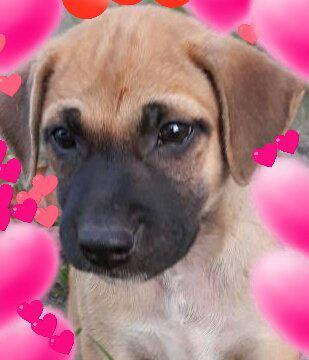|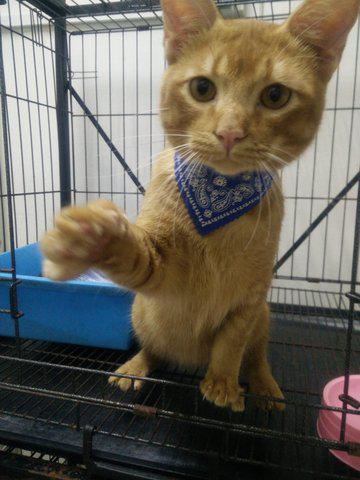

# Import all libraries and dependencies

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy import ndimage

from keras import models
from keras import layers
from keras.layers import Dropout, Flatten, Dense, GlobalAveragePooling2D, Conv2D, MaxPooling2D
from keras.layers import Dense, merge, Dropout, GlobalAveragePooling2D, Input
from keras.layers import Input, SeparableConv2D, Add, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, GlobalMaxPooling2D
from keras import optimizers
from keras_preprocessing.image import ImageDataGenerator
# from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
import keras
from keras.callbacks import ModelCheckpoint, TensorBoard, EarlyStopping, LearningRateScheduler, ReduceLROnPlateau
from tensorflow.keras.applications import DenseNet121
from keras.applications.xception import Xception
from keras.applications import VGG16
from keras.applications import NASNetLarge, InceptionV3
from keras.models import Model
from keras.utils.vis_utils import plot_model
from keras import backend as K

from sklearn.preprocessing import LabelBinarizer, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix

from keras.preprocessing import image
import os, shutil
from IPython.display import display
import os
import cv2
import math
import json
from itertools import islice
import itertools

from hyperas.distributions import uniform
from hyperas import optim
from hyperas.distributions import choice, uniform
from hyperopt import Trials, STATUS_OK, tpe

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

from keras_tqdm import TQDMNotebookCallback

Using TensorFlow backend.


## Load all data from folders into dataframes

In [2]:
bread_labels = pd.read_csv('../pet_data/breed_labels.csv')
color_labels = pd.read_csv('../pet_data/color_labels.csv')
state_labels = pd.read_csv('../pet_data/state_labels.csv')
test_sample_submission = pd.read_csv('../pet_data/test/sample_submission.csv')
test_df = pd.read_csv('../pet_data/test/test.csv')
train_df = pd.read_csv('../pet_data/train.csv')
train_folder = '../pet_data/train_images/'
test_folder = '../pet_data/test_images/'

Output GPU information

In [3]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 15655807546603048882
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 6671596257
locality {
  bus_id: 1
  links {
  }
}
incarnation: 582054722943266753
physical_device_desc: "device: 0, name: GeForce GTX 1080, pci bus id: 0000:00:03.0, compute capability: 6.1"
]


# Create a dictionary with just the PetId and its Type from the train_df dataframe

In [4]:
name_target_dict_type = train_df.set_index('PetID')['Type'].to_dict()
train_image_names = os.listdir('../pet_data/train_images')

In [5]:
list(islice(name_target_dict_type.items(), 5))

[('86e1089a3', 2),
 ('6296e909a', 2),
 ('3422e4906', 1),
 ('5842f1ff5', 1),
 ('850a43f90', 1)]

# Lets look at some of the pets in the image folder

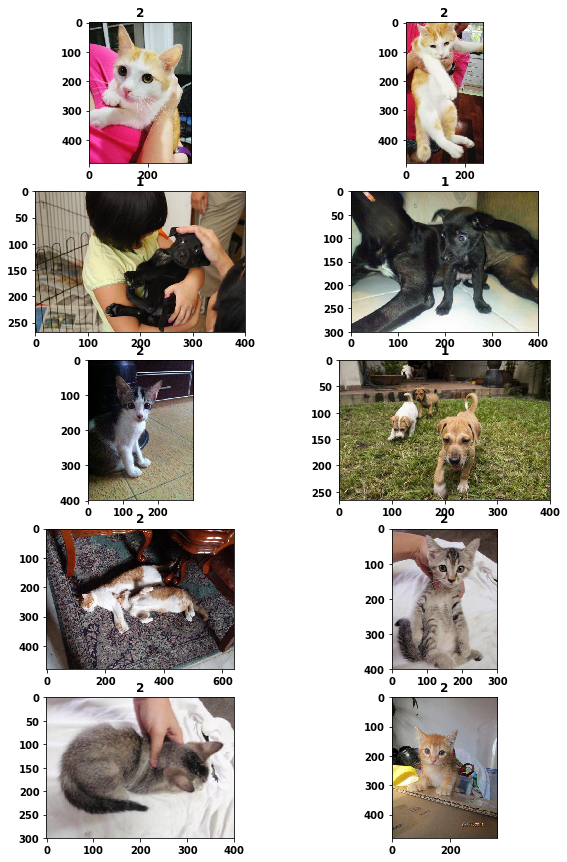

In [6]:
def display_samples(columns=2, rows=5):
    fig=plt.figure(figsize=(5*columns, 3*rows))

    for i in range(columns*rows):
        image_path = train_image_names[i]
        image_id = name_target_dict_type[image_path.split('-')[0]]
        img = plt.imread(f'../pet_data/train_images/{image_path}')
        fig.add_subplot(rows, columns, i+1)
        plt.title(image_id)
        plt.imshow(img)

display_samples()

## whats in the train file?

In [7]:
train_df.drop('Description', axis=1).head()

,Type,Name,Age,Breed1,Breed2,Gender,Color1,Color2,Color3,MaturitySize,...,Sterilized,Health,Quantity,Fee,State,RescuerID,VideoAmt,PetID,PhotoAmt,AdoptionSpeed
0,2,Nibble,3,299,0,1,1,7,0,1,...,2,1,1,100,41326,8480853f516546f6cf33aa88cd76c379,0,86e1089a3,1.0,2
1,2,No Name Yet,1,265,0,1,1,2,0,2,...,3,1,1,0,41401,3082c7125d8fb66f7dd4bff4192c8b14,0,6296e909a,2.0,0
2,1,Brisco,1,307,0,1,2,7,0,2,...,2,1,1,0,41326,fa90fa5b1ee11c86938398b60abc32cb,0,3422e4906,7.0,3
3,1,Miko,4,307,0,2,1,2,0,2,...,2,1,1,150,41401,9238e4f44c71a75282e62f7136c6b240,0,5842f1ff5,8.0,2
4,1,Hunter,1,307,0,1,1,0,0,2,...,2,1,1,0,41326,95481e953f8aed9ec3d16fc4509537e8,0,850a43f90,3.0,2


In [8]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14993 entries, 0 to 14992
Data columns (total 24 columns):
Type             14993 non-null int64
Name             13736 non-null object
Age              14993 non-null int64
Breed1           14993 non-null int64
Breed2           14993 non-null int64
Gender           14993 non-null int64
Color1           14993 non-null int64
Color2           14993 non-null int64
Color3           14993 non-null int64
MaturitySize     14993 non-null int64
FurLength        14993 non-null int64
Vaccinated       14993 non-null int64
Dewormed         14993 non-null int64
Sterilized       14993 non-null int64
Health           14993 non-null int64
Quantity         14993 non-null int64
Fee              14993 non-null int64
State            14993 non-null int64
RescuerID        14993 non-null object
VideoAmt         14993 non-null int64
Description      14981 non-null object
PetID            14993 non-null object
PhotoAmt         14993 non-null float64
AdoptionSpe

In [9]:
train_df.describe()

,Type,Age,Breed1,Breed2,Gender,Color1,Color2,Color3,MaturitySize,FurLength,Vaccinated,Dewormed,Sterilized,Health,Quantity,Fee,State,VideoAmt,PhotoAmt,AdoptionSpeed
count,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000,14993.000000
mean,1.457614,10.452078,265.272594,74.009738,1.776162,2.234176,3.222837,1.882012,1.862002,1.467485,1.731208,1.558727,1.914227,1.036617,1.576069,21.259988,41346.028347,0.056760,3.889215,2.516441
std,0.498217,18.155790,60.056818,123.011575,0.681592,1.745225,2.742562,2.984086,0.547959,0.599070,0.667649,0.695817,0.566172,0.199535,1.472477,78.414548,32.444153,0.346185,3.487810,1.177265
min,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,41324.000000,0.000000,0.000000,0.000000
25%,1.000000,2.000000,265.000000,0.000000,1.000000,1.000000,0.000000,0.000000,2.000000,1.000000,1.000000,1.000000,2.000000,1.000000,1.000000,0.000000,41326.000000,0.000000,2.000000,2.000000
50%,1.000000,3.000000,266.000000,0.000000,2.000000,2.000000,2.000000,0.000000,2.000000,1.000000,2.000000,1.000000,2.000000,1.000000,1.000000,0.000000,41326.000000,0.000000,3.000000,2.000000
75%,2.000000,12.000000,307.000000,179.000000,2.000000,3.000000,6.000000,5.000000,2.000000,2.000000,2.000000,2.000000,2.000000,1.000000,1.000000,0.000000,41401.000000,0.000000,5.000000,4.000000
max,2.000000,255.000000,307.000000,307.000000,3.000000,7.000000,7.000000,7.000000,4.000000,3.000000,3.000000,3.000000,3.000000,3.000000,20.000000,3000.000000,41415.000000,8.000000,30.000000,4.000000


So we have 14993 pets in the training meta data set

# Now lets map the pets image filename to their type. 1 for cat and 2 for dog

In [10]:
generator_dict = {'filename': [], 'type': []}

for name in train_image_names:
    short_name = name.split('-')[0]
    t = name_target_dict_type[short_name]
    
    generator_dict['filename'].append(name)
    generator_dict['type'].append(str(t))
generator_df = pd.DataFrame(generator_dict)
generator_df.head(8)

,filename,type
0,0008c5398-1.jpg,2
1,0008c5398-5.jpg,2
2,000fb9572-1.jpg,1
3,000fb9572-3.jpg,1
4,0011d7c25-1.jpg,2
5,00156db4a-5.jpg,1
6,001a1aaad-1.jpg,2
7,001b1507c-2.jpg,2


## Lets just verify 2 samples

C:\Users\darre\Anaconda3\envs\project_new\lib\site-packages\ipykernel_launcher.py:3: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0.
Use ``matplotlib.pyplot.imread`` instead.
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\darre\Anaconda3\envs\project_new\lib\site-packages\ipykernel_launcher.py:4: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0.
Use ``matplotlib.pyplot.imread`` instead.
  after removing the cwd from sys.path.


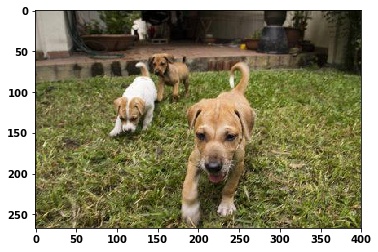

In [11]:
dog = '../pet_data/train_images/00156db4a-5.jpg'
cat = '../pet_data/train_images/0011d7c25-1.jpg'
dog_image = np.expand_dims(ndimage.imread(dog), 0)
cat_image = np.expand_dims(ndimage.imread(cat), 0)
plt.imshow(dog_image[0])

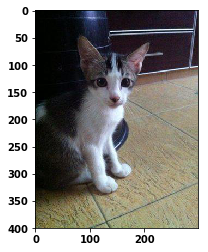

In [12]:
plt.imshow(cat_image[0])

## We can plot a bar graph of the distrobution of cats to dogs

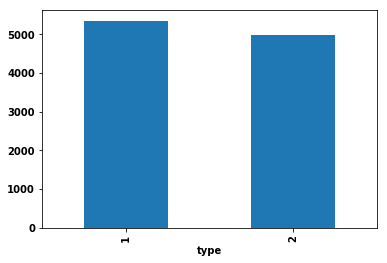

In [13]:
generator_df.groupby('type').size().plot.bar()

In [14]:
generator_df.groupby('type').count()

,filename
type,
1,5351
2,4980


we can see that their 371 more cats than dogs in the images

In [15]:
generator_df.count()

filename    10331
type        10331
dtype: int64

This description shows that not every pet has a picture since there are 14993 pets in the training meta data. it must also be noted that some pets have multiple images

# Getting Ready to create models

Since we are going to be creating and evaluating convolutional neural networks. we will need some utitlity methods to help in our evaluation.

this method is used to create a graphical confusion matrix
<br>to help visualise the predictions from a model

In [16]:

def plot_confusion_matrix(cm, classes, normalize=False, title='confusion matrix', cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)
    
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[: np.newaxis]
        print('normalized confusion matrix')
    else:
        print('unnormalized confusion matrix')
        
    print(cm)
    
    thresh = cm.max() / 2
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                horizontalalignment='center',
                color='white' if cm[i, j] > thresh else 'black'
                )
    plt.tight_layout()
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')

We need a way to plot a models accuracy and loss while training for both the training and validation sets

In [17]:
def plot_history(history):
    plt.plot(history.history['acc'])
    plt.plot(history.history['val_acc'])
    plt.title('model accuracy')
    plt.ylabel('model accuracy')
    plt.xlabel('accuracy')
    plt.legend(['train', 'validation'], loc='upper left')
    plt.show()

    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('model loss')
    plt.xlabel('loss')
    plt.legend(['train', 'validation'], loc='upper left')
    plt.show()

We can show test images with their predicted labels after evaluating a model

In [18]:
def show_image_predictions(probabilities):
    for index, probability in enumerate(probabilities):
        image_path = '../pet_data/train_images/' + test_generator.filenames[index]
        img = mpimg.imread(image_path)
        plt.imshow(img)
        if probability > 0.5:
            plt.title("%.2f" % (probability[0]*100) + "% cat")
        else:
            plt.title("%.2f" % ((1-probability[0])*100) + "% dog")
        plt.show()

When we fit a model we want to use the same steps everytime<br>save the model with its name<br>use callbacks to perform functions while the model is being trained<br>set the image generator sizes

In [19]:
def fit_model(model, model_name, epochs):
    # these callbacks are used to stop a model early
    #reduce the models learning rate while it is training if it plateaus
    # log to tensoboard for visualisation
    callbacks_list = [
        ModelCheckpoint (
            filepath=model_name + '.h5', 
            monitor='val_loss', 
            verbose=0, 
            save_best_only=True, 
            save_weights_only=False,
            mode='auto',),
#         ),
#         EarlyStopping (
#             monitor='val_acc',
#             verbose=1,
#             min_delta=0.01,
#             patience=5,
#         ),
        ReduceLROnPlateau (
            monitor='val_loss',
            factor=0.1,
            verbose=1,
            cooldown=4,
            patience=10,
        ),
        TensorBoard (
            log_dir='my_log_dir',
            embeddings_freq=0,
            write_graph=True
        ),
        TQDMNotebookCallback(leave_inner=True, leave_outer=True)
    ]
    

    STEP_SIZE_TRAIN = train_generator.n//train_generator.batch_size
    STEP_SIZE_VALID = valid_generator.n//valid_generator.batch_size

    # this will return the model history to be graphed
    return model.fit_generator(
        train_generator,
        steps_per_epoch=STEP_SIZE_TRAIN, 
        epochs=epochs,
        callbacks=callbacks_list,
        validation_data=valid_generator,
        validation_steps=STEP_SIZE_VALID,
        verbose=0
    )

a method to visualise the predictions

In [20]:
def prediction_results(model):
    test_datagen=ImageDataGenerator(rescale=1./255.)
    # cut off the last 3 rows as it messes 
    # with the predictions due to the batch size not dividing evenly
    test_mod = test[:-3]
    # create the test generator from the test datasetttt
    test_generator = test_datagen.flow_from_dataframe(
            test_mod, 
            '../pet_data/train_images/', 
            x_col='filename',
            y_col=None, 
            target_size=(150, 150),
            class_mode=None, 
            color_mode='rgb',
            batch_size=16, 
            shuffle=False,
            seed=2018,
        )

    STEP_SIZE_TEST = test_generator.n//test_generator.batch_size

    test_generator.reset()
    # predict the images in the generator object
    image_predictions = model.predict_generator(
        test_generator,
        STEP_SIZE_TEST,
        verbose=1
    )
    # create a dictionary with the filename and its type
    # a 1 for cat and a 2 for dog
    prediction_dict = {'filename': [], 'prediction': []}
    df = pd.DataFrame()

    for index, predict in enumerate(image_predictions):
        filename = test_generator.filenames[index]
        if predict > 0.5:
            prediction_dict['filename'].append(filename) 
            prediction_dict['prediction'].append(2) 
        else: 
            prediction_dict['filename'].append(filename) 
            prediction_dict['prediction'].append(1)

    # create a dataframe with the predictions
    predictions = pd.DataFrame(prediction_dict) 
    # get the true labels
    y_true = test_mod.type.astype(int)
    # get the predicted labels
    y_pred = predictions.prediction

    # now plot a confusion matrix to analyze our results
    plot_confusion_matrix(
        confusion_matrix(y_true, y_pred),
        ['cat', 'dog']
    )
    # we can create a classification report to 
    # see the precision, recall, F1score
    report = classification_report(
        y_true, 
        y_pred, 
        [1, 2]
    )
        
    print(report) 

lets see the validation accuracy and loss

In [21]:
def validation_scores(model):
    # model.load_weights('model.h5')

    validation_scores = model.evaluate_generator(
        valid_generator,
        STEP_SIZE_VALID,
        verbose=1,
    )

    print('Validation loss:', validation_scores[0])
    print('Validation accuracy:', validation_scores[1])

we need to split the data into a training validation_scores and testing set,<br> we use a random seed to ensure we get the same split everytime we run the function

In [22]:

random_state = 42
train, test = train_test_split(
    generator_df, 
    test_size=0.2, 
    random_state=random_state
)

# Image preparation

Before we feed data to a model, the images need to be prepared.<br>
The pixel values need to be rescaled between 0 and 1.<br>
This is so the pixel values will fit between the activation functions of the network.

In [23]:
# creating a training generator
train_datagen=ImageDataGenerator(
    rescale=1/255.,# scale the pixel values
    validation_split=0.1 # set aside 10% of the training set for validation
)

# since we dont have our images sorted into nice folders based
# on whether they are cats or dogs, we need to use a brand new feaure
# in keras (flow_from_dataframe).
# this takes an image name from a dataframe and maps it to an image 
# in a specified folder
def create_generator(subset):
    return train_datagen.flow_from_dataframe(
        train, # the dataframe to get the image name
        '../pet_data/train_images/', # the folder with images
        x_col='filename', # the image to pass to the network
        y_col='type', # the label for an image i.e. cat or dog (1 or 2)
        has_ext=True,  # If image extension is given in x_col
        target_size=(150, 150), # we want to reduce the images to 150 X 150
        color_mode='rgb',
        class_mode='binary', # this will be a binary classification
        batch_size=16, # the batch size to pass to the network
        shuffle=True, 
        seed=2018,
        subset=subset# either training or validation in this case
    )

train_generator = create_generator('training')
valid_generator = create_generator('validation')

STEP_SIZE_TRAIN = train_generator.n//train_generator.batch_size
STEP_SIZE_VALID = valid_generator.n//valid_generator.batch_size

Found 7438 images belonging to 2 classes.
Found 826 images belonging to 2 classes.


# Lets create a model

In [ ]:
# this is just a random model found online
# I did not design or consider this architecture design
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu',
                        input_shape=(150, 150, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dense(512, activation='relu'))

# since this is a binary classifaction the output is 1 node
# the activation is sigmoid which is generally used for binary
# classification
model.add(layers.Dense(1, activation='sigmoid'))

# using the RMSprop optimiser, which is an optimisation alogorithm
model.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])
# fit the model to the training data
history = fit_model(model, 'first_model', 100)

<br>Epoch 1/100
<br>464/464 [==============================] - 48s 103ms/step - loss: 0.6787 - <br>acc: 0.5694 - val_loss: 0.6420 - val_acc: 0.6348
<br>Epoch 2/100
<br>464/464 [==============================] - 42s 90ms/step - loss: 0.6337 - <br>acc: 0.6347 - val_loss: 0.6139 - val_acc: 0.6185
<br>Epoch 97/100
<br>464/464 [==============================] - 42s 91ms/step - loss: 0.0512 - acc: 0.9836 - val_loss: 1.1071 - val_acc: 0.7889
<br>Epoch 98/100
<br>464/464 [==============================] - 42s 91ms/step - loss: 0.0368 - acc: 0.9872 - val_loss: 1.0783 - val_acc: 0.7765
<br>Epoch 99/100
<br>464/464 [==============================] - 42s 90ms/step - loss: 0.0456 - acc: 0.9848 - val_loss: 1.2056 - val_acc: 0.7988
<br>Epoch 100/100
<br>464/464 [==============================] - 42s 90ms/step - loss: 0.0423 - acc: 0.9852 - val_loss: 1.1930 - val_acc: 0.7790


In [ ]:
plot_history(history)
validation_scores(model)
prediction_results(model)

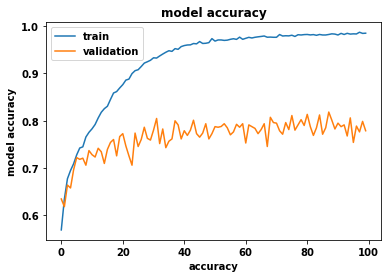

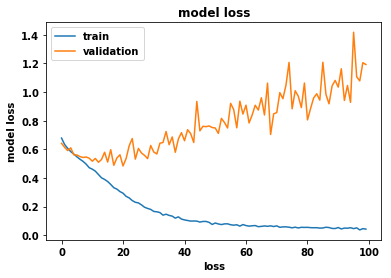

We can see from the graphs that the model is severily overfitting the training data<br> the training accuracy increases linearly over time while the validation stalls after 75-79%.<br>It may be assumed that this overfitting is due to lack of training images.<br>There are a few ways we can get around this. We could use Dropout or some form of weight regularisation etc.<br>Since this is a computer vision problem, we can use something else that is built into keras - Image Augmentation!<br>This method creates synthetic image samples from the existing samples in the training set.<br>It uses various transformation techniques which we will explore in the next section

### Evaluating the test images

<br>51/51 [==============================] - 3s 60ms/step
<br>Validation loss: 1.1724196233131268
<br>Validation accuracy: 0.7679012344207292


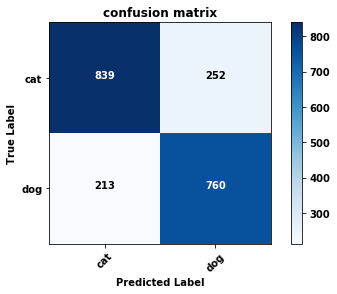

              precision    recall  f1-score   support

           1       0.80      0.77      0.78      1091
           2       0.75      0.78      0.77       973
           
    micro avg      0.77      0.77      0.77      2064
    macro avg      0.77      0.78      0.77      2064
    weighted avg   0.78      0.77      0.77      2064

A lot of room for improvement, Augmentation might improve our results



# Augmentation

In [17]:
# we can specify the type of augmentation we want in the image generator
train_datagen=ImageDataGenerator(
    featurewise_center=False,  # set input mean to 0 over the dataset
    samplewise_center=False,  # set each sample mean to 0
    featurewise_std_normalization=False,  # divide inputs by std of the dataset
    samplewise_std_normalization=False,  # divide each input by its std
    zca_whitening=False,  # apply ZCA whitening
    zca_epsilon=1e-06,  # epsilon for ZCA whitening
    rotation_range=15,  # randomly rotate images in the range (degrees, 0 to 180)
    width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
    height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
    shear_range=0.1,  # set range for random shear
    zoom_range=0.1,  # set range for random zoom
    channel_shift_range=0.,  # set range for random channel shifts
    # set mode for filling points outside the input boundaries
    fill_mode='nearest',
    cval=0.,  # value used for fill_mode = "constant"
    horizontal_flip=True,  # randomly flip images
    vertical_flip=False,  # randomly flip images
    # set rescaling factor (applied before any other transformation)
    rescale=1/255.,
    # set function that will be applied on each input
    preprocessing_function=None,
    # fraction of images reserved for validation (strictly between 0 and 1)
    validation_split=0.1
)

def create_generator(subset):
    return train_datagen.flow_from_dataframe(
        train, 
        '../pet_data/train_images/', 
        x_col='filename',
        y_col='type', 
        has_ext=True,  # If image extension is given in x_col
        target_size=(150, 150), 
        color_mode='rgb',
        class_mode='binary', 
        batch_size=16, 
        shuffle=True, 
        seed=2018,
        subset=subset
    )

train_generator = create_generator('training')
valid_generator = create_generator('validation')

STEP_SIZE_TRAIN = train_generator.n//train_generator.batch_size
STEP_SIZE_VALID = valid_generator.n//valid_generator.batch_size

Found 7438 images belonging to 2 classes.
Found 826 images belonging to 2 classes.


We can reuse the same model, but the augmentation alone may not be enough<br> 
we can also add a dropout layer before the dense output layer

In [ ]:
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu',
                        input_shape=(150, 150, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
# adding a dropout layer which will drop 50% of the nodes
# dropout removes some of the data as to help the model better generalise
model.add(layers.Dropout(0.5))
model.add(layers.Dense(512, activation='relu'))ense(1, activation='sigmoid'))

model.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

history = fit_model(model, 'second_model', 100)
plot_history(history)
validation_scores(model)
prediction_results(model)

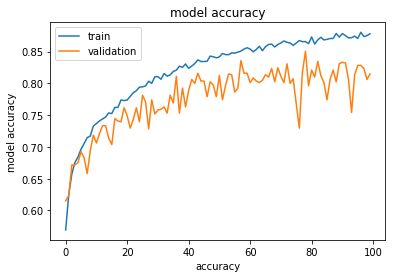

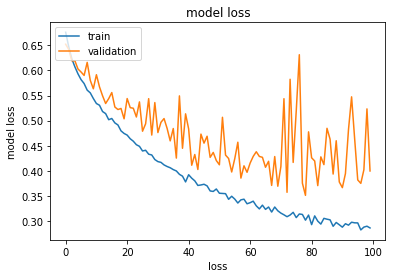

Great! this seems to have reduced the overfitting, but it could be better

<br>51/51 [==============================] - 6s 125ms/step
<br>Validation loss: 0.3923267865297841
<br>Validation accuracy: 0.8186274509803921
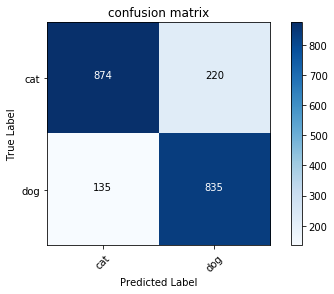

              precision    recall  f1-score   support

           1       0.87      0.80      0.83      1094
           2       0.79      0.86      0.82       970
           
    micro avg      0.83      0.83      0.83      2064
    macro avg      0.83      0.83      0.83      2064
    weighted avg   0.83      0.83      0.83      2064

<br>This looks like we're on the right track - 83% testing accuracy, which is 2% above the validation accuracy - this can be put down to chance

To improve upon this result we will need to look at the networks architecture a bit closer and consider the hyperparameters used.

# Network Architecture Design

So far we took the blind approach to designing a networks design. We need to reference the state of the art to get inspiration.<br>Luckily all the papers from the ImageNet Challenge over the last few years are easy to find on arxiv.org.<br>From the research conducted, there seemed to be some common trends.<br>Deeper models learn more features in images, this was shown with VGG.<br>Batch Normalisation - this helps with gradient propagation by normalising values from a layer of a network.<br>DepthWise Seperable Convolutions - this type of convolutional layer is used throughout the Xception model, which is the state of the art at time of writing this.<br>These layers can be swapped in for regular Conv2D layers, and are faster and more light weight.<br>The hyper-parameters of the network also need to be adjusted ,how many layers? what optimizer?, how many filters?, how much dropout?<br>Residual Connections may also be investiged, but the models used in this notebook may not be big enough to require residual connections. 

# Adding BatchNormalization

In [16]:
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu',
                        input_shape=(150, 150, 3)))
# it is recommended to add a BatchNormalization layer after a Conv2d layer
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dropout(0.5))
model.add(layers.Dense(512, activation='relu'))
# or a regular Dense layer
model.add(layers.BatchNormalization())
model.add(layers.Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

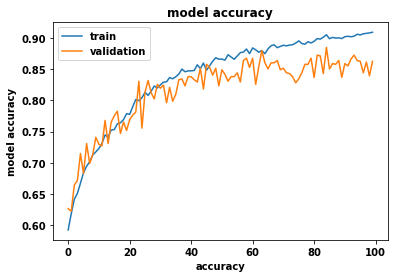

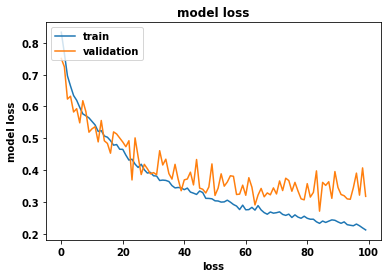

In [19]:
history = fit_model(model, 'batch_model', 100)
plot_history(history)

Batch normalization has once again helped by reducing overfitting. it also has boosted our validation accuracy by 2% and lowered our validation loss. 

In [20]:
validation_scores(model)

51/51 [==============================] - 8s 162ms/step
Validation loss: 0.3536202784673667
Validation accuracy: 0.8395061728395061


unnormalized confusion matrix
[[926 110]
 [215 813]]


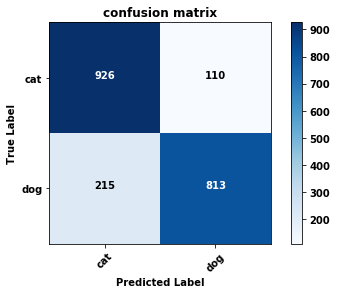

In [25]:
prediction_results(model)

This has also improved our test accuracy by 1%

              precision    recall  f1-score   support

           1       0.81      0.89      0.85      1036
           2       0.88      0.79      0.83      1028

    micro avg      0.84      0.84      0.84      2064
    macro avg      0.85      0.84      0.84      2064
    weighted avg   0.85      0.84      0.84      2064



# DEPTHWISE SEPARABLE CONVOLUTION

Lets try changing all the Conv2D layers to SeparableConv2D without batch normalisation

In [28]:
model = models.Sequential()
model.add(layers.SeparableConv2D(32, (3, 3), activation='relu',
                        input_shape=(150, 150, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.SeparableConv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.SeparableConv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.SeparableConv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dropout(0.5))
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

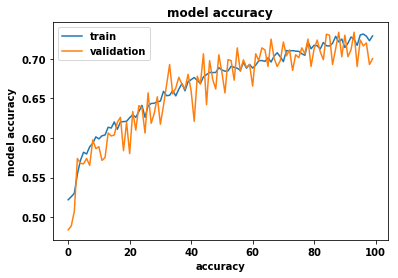

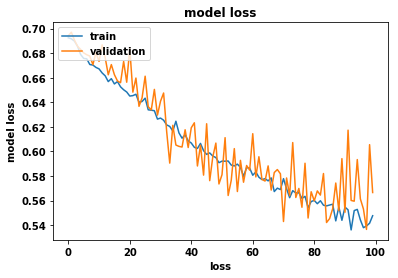

In [33]:
history = fit_model(model, 'sep_model', 100)
plot_history(history)

This seems to have reduced overfitting, but at the price of overall accuracy and loss. not what was expected

51/51 [==============================] - 8s 163ms/step
Validation loss: 0.5396013140678406
Validation accuracy: 0.7222222223693942


unnormalized confusion matrix
[[789 247]
 [299 729]]


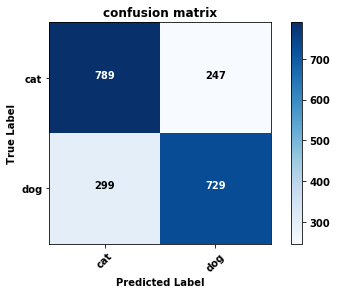

In [38]:
prediction_results(model)

              precision    recall  f1-score   support

           1       0.73      0.76      0.74      1036
           2       0.75      0.71      0.73      1028

   micro avg       0.74      0.74      0.74      2064
   macro avg       0.74      0.74      0.74      2064
weighted avg       0.74      0.74      0.74      2064



Looks like this feature has made our model worse

# Lets try both together

In [14]:
model = models.Sequential()

model.add(layers.SeparableConv2D(32, (3, 3), activation='relu',
                        input_shape=(150, 150, 3)))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.SeparableConv2D(64, (3, 3), activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.SeparableConv2D(128, (3, 3), activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.SeparableConv2D(128, (3, 3), activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.Flatten())
model.add(layers.Dropout(0.5))
model.add(layers.Dense(512, activation='relu'))
model.add(layers.BatchNormalization())

model.add(layers.Dense(1, activation='sigmoid'))

model.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


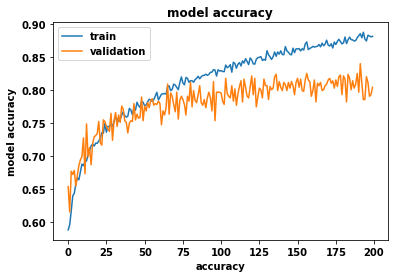

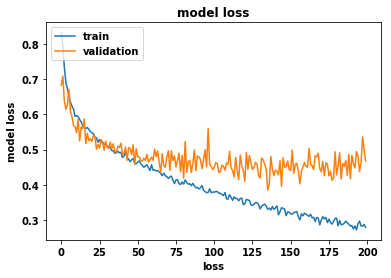

In [16]:
plot_history(history)

Lets abandon depthwise separable convolutions for now

# Adding more dropout

By adding more dropout, we should hopefully see the overfitting reduce

In [68]:
dropout_model = models.Sequential()
dropout_model.add(layers.Conv2D(32, (3, 3), activation='relu',
                        input_shape=(150, 150, 3)))
dropout_model.add(layers.BatchNormalization())
# adding a dropout layer early in the network on 20% of nodes
dropout_model.add(layers.Dropout(0.2))
dropout_model.add(layers.MaxPooling2D((2, 2)))

dropout_model.add(layers.Conv2D(64, (3, 3), activation='relu'))
dropout_model.add(layers.BatchNormalization())
dropout_model.add(layers.MaxPooling2D((2, 2)))

dropout_model.add(layers.Conv2D(128, (3, 3), activation='relu'))
dropout_model.add(layers.BatchNormalization())
dropout_model.add(layers.MaxPooling2D((2, 2)))

dropout_model.add(layers.Conv2D(128, (3, 3), activation='relu'))
dropout_model.add(layers.BatchNormalization())
dropout_model.add(layers.MaxPooling2D((2, 2)))

dropout_model.add(layers.Flatten())
dropout_model.add(layers.Dropout(0.5))
dropout_model.add(layers.Dense(512, activation='relu'))
dropout_model.add(layers.BatchNormalization())

dropout_model.add(layers.Dense(1, activation='sigmoid'))
dropout_model.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

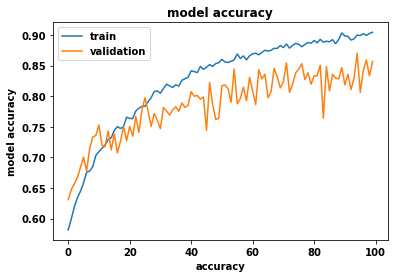

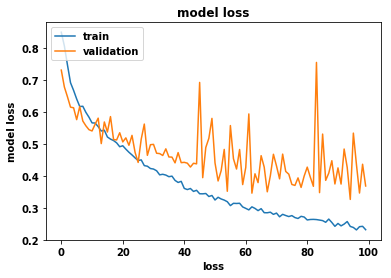

In [71]:
dropout_history = fit_model(dropout_model, 'dropout_model', 100)
plot_history(dropout_history)

Adding more dropout has improved performance and helped reduce overfitting

In [72]:
validation_scores(dropout_model)

51/51 [==============================] - 8s 161ms/step
Validation loss: 0.35157826557571503
Validation accuracy: 0.862962962668619


Found 2064 images.
129/129 [==============================] - 9s 73ms/step
unnormalized confusion matrix
[[949 131]
 [157 827]]
              precision    recall  f1-score   support

           1       0.86      0.88      0.87      1080
           2       0.86      0.84      0.85       984

   micro avg       0.86      0.86      0.86      2064
   macro avg       0.86      0.86      0.86      2064
weighted avg       0.86      0.86      0.86      2064



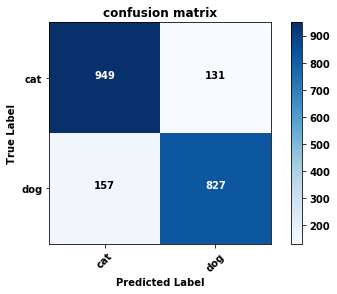

In [80]:
prediction_results(dropout_model)

Lets add another dropout layer

In [82]:
dropout_model2 = models.Sequential()

dropout_model2.add(layers.Conv2D(32, (3, 3), activation='relu',
                        input_shape=(150, 150, 3)))
dropout_model2.add(layers.BatchNormalization())
dropout_model2.add(layers.MaxPooling2D((2, 2)))
# dropout 1
dropout_model2.add(layers.Dropout(0.2))

dropout_model2.add(layers.Conv2D(64, (3, 3), activation='relu'))
dropout_model2.add(layers.BatchNormalization())
dropout_model2.add(layers.MaxPooling2D((2, 2)))
# dropout 2
dropout_model2.add(layers.Dropout(0.2))

dropout_model2.add(layers.Conv2D(128, (3, 3), activation='relu'))
dropout_model2.add(layers.BatchNormalization())
dropout_model2.add(layers.MaxPooling2D((2, 2)))

dropout_model2.add(layers.Conv2D(128, (3, 3), activation='relu'))
dropout_model2.add(layers.BatchNormalization())
dropout_model2.add(layers.MaxPooling2D((2, 2)))

dropout_model2.add(layers.Flatten())
dropout_model2.add(layers.Dropout(0.5))
dropout_model2.add(layers.Dense(512, activation='relu'))
dropout_model2.add(layers.BatchNormalization())

dropout_model2.add(layers.Dense(1, activation='sigmoid'))

dropout_model2.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

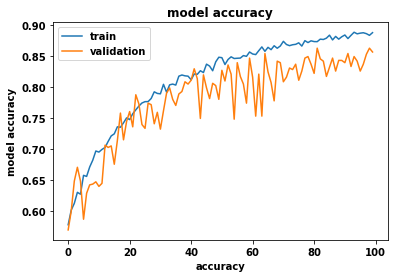

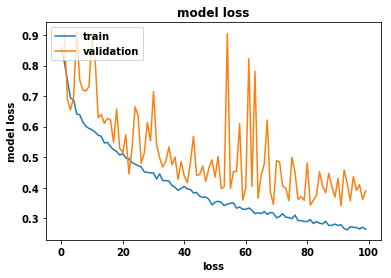

In [86]:
dropout_history2 = fit_model(dropout_model2, 'dropout_model2', 100)
plot_history(dropout_history2)

By looking at the graph, overfitting is nearly gone and performance has increased

In [87]:
validation_scores(dropout_model2)

51/51 [==============================] - 8s 159ms/step
Validation loss: 0.40318114742820643
Validation accuracy: 0.8493827161965547


Found 2064 images.
129/129 [==============================] - 9s 68ms/step
unnormalized confusion matrix
[[970 110]
 [158 826]]
              precision    recall  f1-score   support

           1       0.86      0.90      0.88      1080
           2       0.88      0.84      0.86       984

   micro avg       0.87      0.87      0.87      2064
   macro avg       0.87      0.87      0.87      2064
weighted avg       0.87      0.87      0.87      2064



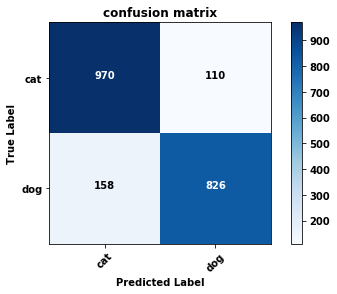

In [88]:
prediction_results(dropout_model2)

We now have 87% accuracy on the test set

In [105]:
dropout_model4 = models.Sequential()

dropout_model4.add(layers.Conv2D(32, (3, 3), activation='relu',
                        input_shape=(150, 150, 3)))
dropout_model4.add(layers.BatchNormalization())
# increase dropout rate from 0.2 to 0.5
dropout_model4.add(layers.Dropout(0.5))
dropout_model4.add(layers.MaxPooling2D((2, 2)))

dropout_model4.add(layers.Conv2D(64, (3, 3), activation='relu'))
dropout_model4.add(layers.BatchNormalization())
dropout_model4.add(layers.MaxPooling2D((2, 2)))
dropout_model4.add(layers.Dropout(0.2))

dropout_model4.add(layers.Conv2D(128, (3, 3), activation='relu'))
dropout_model4.add(layers.BatchNormalization())
dropout_model4.add(layers.MaxPooling2D((2, 2)))

dropout_model4.add(layers.Conv2D(128, (3, 3), activation='relu'))
dropout_model4.add(layers.BatchNormalization())
dropout_model4.add(layers.MaxPooling2D((2, 2)))

dropout_model4.add(layers.Flatten())
dropout_model4.add(layers.Dropout(0.5))
dropout_model4.add(layers.Dense(512, activation='relu'))
dropout_model4.add(layers.BatchNormalization())

dropout_model4.add(layers.Dense(1, activation='sigmoid'))

dropout_model4.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

model4_history = fit_model(dropout_model4, 'dropout_model4')

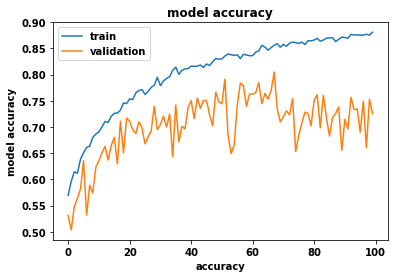

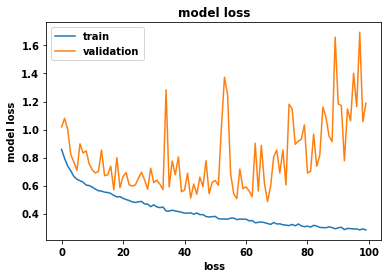

In [107]:
plot_history(model4_history)

Yikes! increasing the dropout rate on the first layer did not work out too well.

In [108]:
validation_scores(dropout_model2)

51/51 [==============================] - 8s 157ms/step
Validation loss: 1.0978652007785845
Validation accuracy: 0.7246913581718634


Found 2064 images.
129/129 [==============================] - 9s 69ms/step
unnormalized confusion matrix
[[983  97]
 [378 606]]
              precision    recall  f1-score   support

           1       0.72      0.91      0.81      1080
           2       0.86      0.62      0.72       984

   micro avg       0.77      0.77      0.77      2064
   macro avg       0.79      0.76      0.76      2064
weighted avg       0.79      0.77      0.76      2064



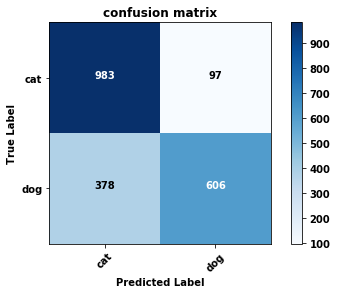

In [109]:
prediction_results(dropout_model2)

This shows that there is a point of diminishing returns, when it comes to the amount of dropout used. Strangly from the confusion matrix, it just seems to have made the model worse at classifying dogs!!!

# Create residual connections

ResNet won the ImageNet competition with a model that had 152 layers. A network can learn more details of images the deeper they go, but they also experience a vanishing gradient problem during back-propagation. <br>A team at Microsoft created ResNet and used residual connections to add the output of a previous layer to the output of a later layers activation function. this let later layers retain weight from earlier layers, allowing for deeper networks.<br><br>Since our architecure is beginning to get deep, we can try implementing a residual connection and see how it performs.<br> to do this we will need to use the functional API from Keras, which allows you to define directed asyclic graph networks.

In [30]:
inp = Input(shape=(150, 150, 3))

# beginning
y = Conv2D(64, (3, 3), padding='same')(inp)
y = BatchNormalization()(y)
y = MaxPooling2D((2, 2))(y)

# Conv block
x_short = y

y = Conv2D(128, (1, 1), padding='same')(y)
y = BatchNormalization()(y)
y = Activation('relu')(y)

y = Conv2D(256, (3, 3), padding='same')(y)
y = BatchNormalization()(y)
y = Activation('relu')(y)

y = Conv2D(32, (1, 1), padding='valid')(y)
y = BatchNormalization()(y)

x_short = Conv2D(32, kernel_size=(1, 1), padding='valid')(x_short)
x_short = BatchNormalization()(x_short)

# adding layers in conv block
y = layers.add([x_short, y])
y = Activation('relu')(y)

# identity block

x = y

y = Conv2D(512, (3, 3), padding='same')(y)
y = BatchNormalization()(y)
y = Activation('relu')(y)

y = Conv2D(1024, (3, 3), padding='same')(y)
y = BatchNormalization()(y)
y = Activation('relu')(y)

y = Conv2D(32, (3, 3), padding='same')(y)
y = BatchNormalization()(y)

# adding the input to the last output
y = layers.add([x, y])
y = Activation('relu')(y)

# end identity
y = AveragePooling2D((2, 2), padding='same')(y)
y = Flatten()(y)
y = Dense(1, activation='sigmoid')(y)

model = Model(input=inp, output=y)

model.compile(loss='binary_crossentropy',
              optimizer=optimizers.Adam(lr=0.0001),
              metrics=['acc'])

C:\Users\darre\Anaconda3\envs\project_new\lib\site-packages\ipykernel_launcher.py:53: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("de...)`


In [31]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_12 (Conv2D)              (None, 150, 150, 64) 1792        input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_40 (BatchNo (None, 150, 150, 64) 256         conv2d_12[0][0]                  
__________________________________________________________________________________________________
max_pooling2d_8 (MaxPooling2D)  (None, 75, 75, 64)   0           batch_normalization_40[0][0]     
__________________________________________________________________________________________________
conv2d_13 

We can see from the summary of this model that it looks different from models from the sequential API

In [59]:
real_resnet_model = fit_model(model, 'real_resnet', 50)

Epoch 1/50
464/464 [==============================] - 150s 324ms/step - loss: 0.8413 - acc: 0.5644 - val_loss: 0.8595 - val_acc: 0.5333
Epoch 2/50
464/464 [==============================] - 140s 303ms/step - loss: 0.7102 - acc: 0.6059 - val_loss: 0.5733 - val_acc: 0.7198
Epoch 3/50
464/464 [==============================] - 141s 303ms/step - loss: 0.6574 - acc: 0.6386 - val_loss: 0.7381 - val_acc: 0.5852
Epoch 4/50
464/464 [==============================] - 142s 305ms/step - loss: 0.6330 - acc: 0.6623 - val_loss: 0.8165 - val_acc: 0.5383
Epoch 5/50
464/464 [==============================] - 148s 320ms/step - loss: 0.6114 - acc: 0.6749 - val_loss: 0.5948 - val_acc: 0.6852
Epoch 6/50
464/464 [==============================] - 145s 313ms/step - loss: 0.5887 - acc: 0.6913 - val_loss: 0.6007 - val_acc: 0.6864
Epoch 7/50
464/464 [==============================] - 149s 321ms/step - loss: 0.5811 - acc: 0.7017 - val_loss: 0.5873 - val_acc: 0.7247
Epoch 8/50
464/464 [============================

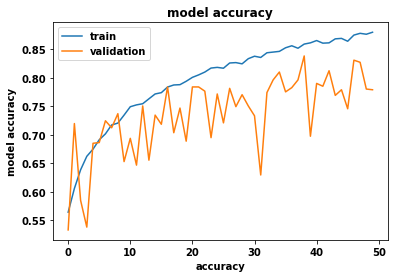

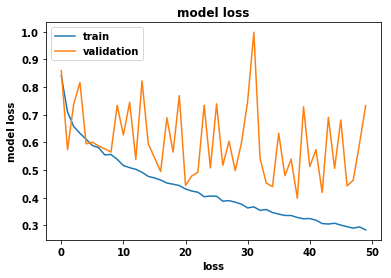

51/51 [==============================] - 8s 161ms/step
Validation loss: 0.689371590702622
Validation accuracy: 0.7728395063200114
Found 2064 images.
129/129 [==============================] - 14s 109ms/step
unnormalized confusion matrix
[[902 178]
 [208 776]]
              precision    recall  f1-score   support

           1       0.81      0.84      0.82      1080
           2       0.81      0.79      0.80       984

   micro avg       0.81      0.81      0.81      2064
   macro avg       0.81      0.81      0.81      2064
weighted avg       0.81      0.81      0.81      2064



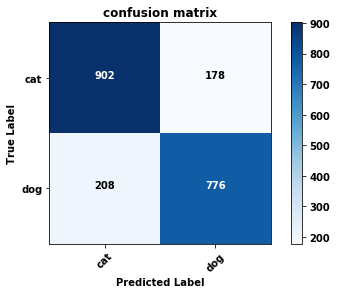

In [60]:
plot_history(real_resnet_model)
validation_scores(model)
prediction_results(model)

After 50 epochs we get a validation acc of 77% and a loss of 0.68<br>and test accuracy of 81%<br><br>Lets run for 100 epochs

In [ ]:
res_100_model = model
real_resnet_model_100_plot = fit_model(res_100_model, 'real_resnet', 100)

In [ ]:
plot_history(real_resnet_model_100_plot)
validation_scores(res_100_model)
prediction_results(res_100_model)

In [32]:
res_100_model_earlystopping = model

early_resnet_model_100_plot = fit_model(
    res_100_model_earlystopping, 
    'real_resnet', 100
)

Epoch 1/100
464/464 [==============================] - 149s 320ms/step - loss: 0.7755 - acc: 0.5869 - val_loss: 0.7149 - val_acc: 0.5864
Epoch 2/100
464/464 [==============================] - 142s 305ms/step - loss: 0.6640 - acc: 0.6240 - val_loss: 0.7616 - val_acc: 0.5630
Epoch 3/100
464/464 [==============================] - 142s 306ms/step - loss: 0.6444 - acc: 0.6499 - val_loss: 0.5989 - val_acc: 0.6802
Epoch 4/100
464/464 [==============================] - 142s 306ms/step - loss: 0.6212 - acc: 0.6631 - val_loss: 0.6014 - val_acc: 0.6642
Epoch 5/100
464/464 [==============================] - 142s 306ms/step - loss: 0.5987 - acc: 0.6838 - val_loss: 0.6739 - val_acc: 0.6049
Epoch 6/100
464/464 [==============================] - 141s 304ms/step - loss: 0.5960 - acc: 0.6878 - val_loss: 0.6920 - val_acc: 0.6457
Epoch 7/100
464/464 [==============================] - 141s 305ms/step - loss: 0.5803 - acc: 0.6962 - val_loss: 0.5679 - val_acc: 0.7136
Epoch 8/100
464/464 [====================

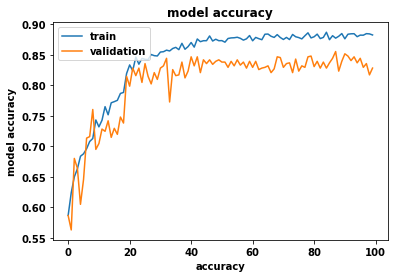

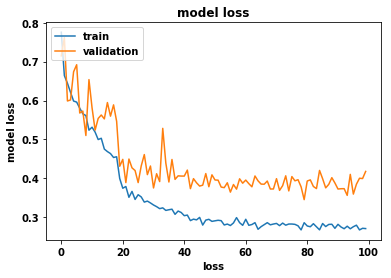

51/51 [==============================] - 8s 157ms/step
Validation loss: 0.37168399213272846
Validation accuracy: 0.8481481482953201
Found 2064 images.
129/129 [==============================] - 14s 105ms/step
unnormalized confusion matrix
[[926 154]
 [225 759]]
              precision    recall  f1-score   support

           1       0.80      0.86      0.83      1080
           2       0.83      0.77      0.80       984

   micro avg       0.82      0.82      0.82      2064
   macro avg       0.82      0.81      0.82      2064
weighted avg       0.82      0.82      0.82      2064



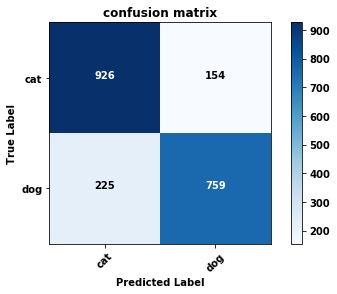

In [33]:
plot_history(early_resnet_model_100_plot)
validation_scores(res_100_model_earlystopping)
prediction_results(res_100_model_earlystopping)

These results are slightly better, but not our best so far. It seems that our model may be too small for a residual connection

# VGG16 style

As it turns out the model that was designed in the beginning was actually quite similar to the VGG16 model. The one thing that was different was that the convolutional layers are doubled up with VGG. Lets double our layers and remove the batch normalization, since VGG didnt use it

In [21]:
vgg = models.Sequential()

vgg.add(layers.Conv2D(64, (3, 3), activation='relu', 
                      input_shape=(150, 150, 3), padding='same'))
vgg.add(layers.Conv2D(64, (3, 3), activation='relu', padding='same'))
vgg.add(layers.MaxPooling2D((2, 2)))

vgg.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
vgg.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
vgg.add(layers.MaxPooling2D((2, 2)))

vgg.add(layers.Conv2D(256, (3, 3), activation='relu', padding='same'))
vgg.add(layers.Conv2D(256, (3, 3), activation='relu', padding='same'))
vgg.add(layers.MaxPooling2D((2, 2)))

vgg.add(layers.Flatten())
vgg.add(layers.Dense(256, activation='relu'))

vgg.add(layers.Dense(1, activation='sigmoid'))

vgg.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

In [22]:
vgg.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 150, 150, 64)      1792      
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 150, 150, 64)      36928     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 75, 75, 64)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 75, 75, 128)       73856     
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 75, 75, 128)       147584    
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 37, 37, 128)       0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 37, 37, 256)       295168    
__________

In [23]:
vgg_plot = fit_model(vgg, 'my_vgg', 100)

Epoch 1/100
464/464 [==============================] - 92s 199ms/step - loss: 0.6809 - acc: 0.5679 - val_loss: 0.6343 - val_acc: 0.6568
Epoch 2/100
464/464 [==============================] - 90s 194ms/step - loss: 0.6503 - acc: 0.6222 - val_loss: 0.6587 - val_acc: 0.6284
Epoch 3/100
464/464 [==============================] - 90s 195ms/step - loss: 0.6301 - acc: 0.6520 - val_loss: 0.6102 - val_acc: 0.6654
Epoch 4/100
464/464 [==============================] - 89s 193ms/step - loss: 0.6170 - acc: 0.6656 - val_loss: 0.5891 - val_acc: 0.7062
Epoch 5/100
464/464 [==============================] - 90s 193ms/step - loss: 0.6073 - acc: 0.6735 - val_loss: 0.5801 - val_acc: 0.6975
Epoch 6/100
464/464 [==============================] - 89s 192ms/step - loss: 0.5912 - acc: 0.6828 - val_loss: 0.5597 - val_acc: 0.7230
Epoch 7/100
464/464 [==============================] - 89s 192ms/step - loss: 0.5718 - acc: 0.7047 - val_loss: 0.5638 - val_acc: 0.7086
Epoch 8/100
464/464 [===========================

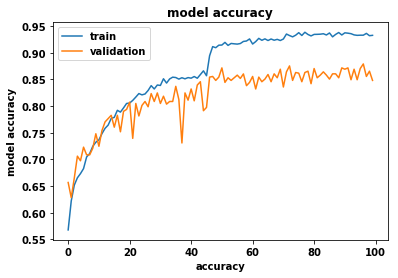

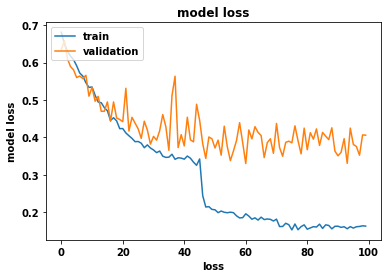

51/51 [==============================] - 8s 153ms/step
Validation loss: 0.34505781733695373
Validation accuracy: 0.8691358021747919
Found 2064 images.
129/129 [==============================] - 9s 67ms/step
unnormalized confusion matrix
[[970 110]
 [151 833]]
              precision    recall  f1-score   support

           1       0.87      0.90      0.88      1080
           2       0.88      0.85      0.86       984

   micro avg       0.87      0.87      0.87      2064
   macro avg       0.87      0.87      0.87      2064
weighted avg       0.87      0.87      0.87      2064



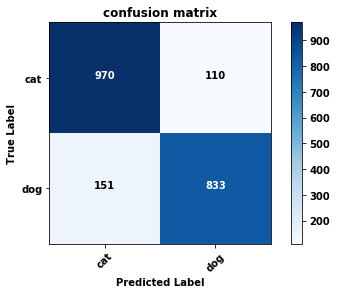

In [28]:
plot_history(vgg_plot)
validation_scores(vgg)
prediction_results(vgg)

These results are pretty good but definitely look like they are overfitting after about 40 epochs! Lets add our BatchNormalization back and see does it help

In [27]:
vgg = models.Sequential()

vgg.add(layers.Conv2D(64, (3, 3), activation='relu', 
                      input_shape=(150, 150, 3), padding='same'))
vgg.add(layers.Conv2D(64, (3, 3), activation='relu', padding='same'))
vgg.add(layers.BatchNormalization()) # added back
vgg.add(layers.MaxPooling2D((2, 2)))

vgg.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
vgg.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
vgg.add(layers.BatchNormalization())# added back
vgg.add(layers.MaxPooling2D((2, 2)))

vgg.add(layers.Conv2D(256, (3, 3), activation='relu', padding='same'))
vgg.add(layers.Conv2D(256, (3, 3), activation='relu', padding='same'))
vgg.add(layers.BatchNormalization())# added back
vgg.add(layers.MaxPooling2D((2, 2)))

vgg.add(layers.Flatten())
vgg.add(layers.Dropout(0.5))
vgg.add(layers.Dense(256, activation='relu'))
vgg.add(layers.BatchNormalization())# added back

vgg.add(layers.Dense(1, activation='sigmoid'))

vgg.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

In [28]:
vgg.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_27 (Conv2D)           (None, 150, 150, 64)      1792      
_________________________________________________________________
conv2d_28 (Conv2D)           (None, 150, 150, 64)      36928     
_________________________________________________________________
batch_normalization_29 (Batc (None, 150, 150, 64)      256       
_________________________________________________________________
max_pooling2d_15 (MaxPooling (None, 75, 75, 64)        0         
_________________________________________________________________
conv2d_29 (Conv2D)           (None, 75, 75, 128)       73856     
_________________________________________________________________
conv2d_30 (Conv2D)           (None, 75, 75, 128)       147584    
_________________________________________________________________
batch_normalization_30 (Batc (None, 75, 75, 128)       512       
__________

In [29]:
vgg2_plot = fit_model(vgg, 'my_vgg2', 100)


Epoch 1/100
464/464 [==============================] - 93s 200ms/step - loss: 0.8372 - acc: 0.5760 - val_loss: 0.9263 - val_acc: 0.5235
Epoch 2/100
464/464 [==============================] - 89s 192ms/step - loss: 0.7045 - acc: 0.6020 - val_loss: 0.7020 - val_acc: 0.6025
Epoch 3/100
464/464 [==============================] - 89s 193ms/step - loss: 0.6530 - acc: 0.6311 - val_loss: 0.7469 - val_acc: 0.5735
Epoch 4/100
464/464 [==============================] - 89s 191ms/step - loss: 0.6165 - acc: 0.6707 - val_loss: 0.5966 - val_acc: 0.7136
Epoch 5/100
464/464 [==============================] - 89s 192ms/step - loss: 0.6031 - acc: 0.6871 - val_loss: 0.6721 - val_acc: 0.6136
Epoch 6/100
464/464 [==============================] - 90s 193ms/step - loss: 0.5691 - acc: 0.7099 - val_loss: 0.5724 - val_acc: 0.7000
Epoch 7/100
464/464 [==============================] - 89s 191ms/step - loss: 0.5485 - acc: 0.7212 - val_loss: 0.5662 - val_acc: 0.6914
Epoch 8/100
464/464 [===========================

NameError: name 'vgg_plot2' is not defined

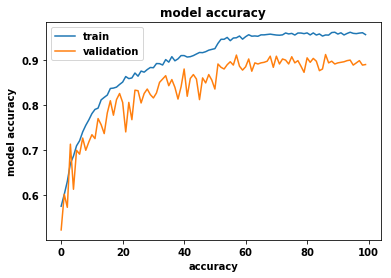

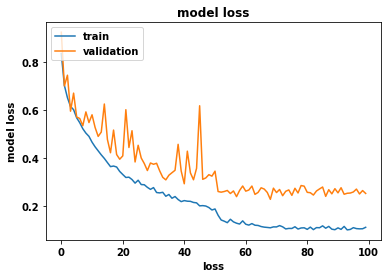

51/51 [==============================] - 8s 152ms/step
Validation loss: 0.2636764744917552
Validation accuracy: 0.8975308643447029
Found 2064 images.
129/129 [==============================] - 8s 66ms/step
unnormalized confusion matrix
[[986  94]
 [132 852]]
              precision    recall  f1-score   support

           1       0.88      0.91      0.90      1080
           2       0.90      0.87      0.88       984

   micro avg       0.89      0.89      0.89      2064
   macro avg       0.89      0.89      0.89      2064
weighted avg       0.89      0.89      0.89      2064



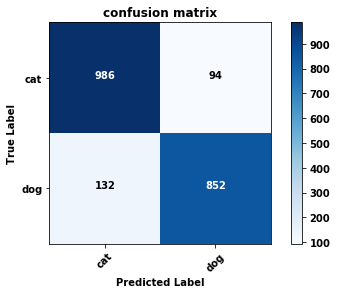

In [30]:
plot_history(vgg2_plot)
validation_scores(vgg)
prediction_results(vgg)

Great this is the best result so far! vaidation accuracy of 89% and a loss of 0.26<br> test accuracy of 89%<br><br>one thing that has not been changed is the optimizer, we have been using RMSprop all along, lets try Adam

In [33]:
vgg3 = vgg

vgg3.compile(loss='binary_crossentropy',
              optimizer='Adam',
              metrics=['acc'])

Epoch 1/100
464/464 [==============================] - 91s 196ms/step - loss: 0.6043 - acc: 0.6923 - val_loss: 0.9191 - val_acc: 0.5630
Epoch 2/100
464/464 [==============================] - 88s 191ms/step - loss: 0.5054 - acc: 0.7519 - val_loss: 0.6532 - val_acc: 0.6272
Epoch 3/100
464/464 [==============================] - 89s 191ms/step - loss: 0.4919 - acc: 0.7621 - val_loss: 0.5282 - val_acc: 0.7444
Epoch 4/100
464/464 [==============================] - 88s 191ms/step - loss: 0.4744 - acc: 0.7703 - val_loss: 1.1082 - val_acc: 0.4914
Epoch 5/100
464/464 [==============================] - 88s 190ms/step - loss: 0.4469 - acc: 0.7883 - val_loss: 0.8569 - val_acc: 0.4951
Epoch 6/100
464/464 [==============================] - 88s 190ms/step - loss: 0.4868 - acc: 0.7615 - val_loss: 0.7256 - val_acc: 0.6173
Epoch 7/100
464/464 [==============================] - 88s 190ms/step - loss: 0.4158 - acc: 0.8092 - val_loss: 0.4528 - val_acc: 0.7877
Epoch 8/100
464/464 [===========================

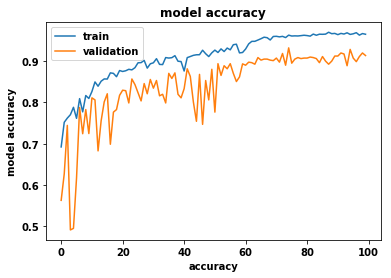

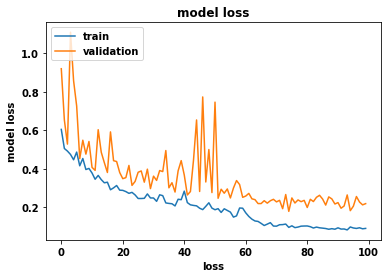

51/51 [==============================] - 8s 154ms/step
Validation loss: 0.2112577524634055
Validation accuracy: 0.9148148148148149
Found 2064 images.
129/129 [==============================] - 9s 67ms/step
unnormalized confusion matrix
[[1003   77]
 [ 100  884]]
              precision    recall  f1-score   support

           1       0.91      0.93      0.92      1080
           2       0.92      0.90      0.91       984

   micro avg       0.91      0.91      0.91      2064
   macro avg       0.91      0.91      0.91      2064
weighted avg       0.91      0.91      0.91      2064



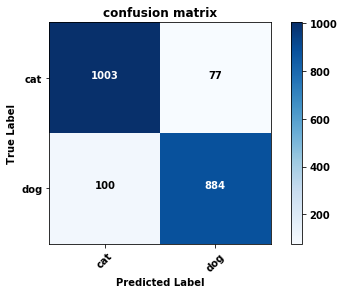

In [34]:
vgg3_plot = fit_model(vgg3, 'my_vgg3', 100)
plot_history(vgg3_plot)
validation_scores(vgg3)
prediction_results(vgg3)

Another improvement - 91% on the test accuracy, it seems that the Adam optimizer is better suited to this network.

# Xception Style

The Xception model is currently the state of the art was designed by the creator of the Keras library. It uses the Depthwise Separable Convolutions that were used earlier (with limited success).<br>this architecture uses residual connections also. It basically uses all the techniques explored so far in this notebook, and is actually quite a lightweight model compared to some others.

In [35]:
img_input = Input(shape=(150, 150, 3))

x = Conv2D(32, (3, 3), strides=(2, 2))(img_input)
x = BatchNormalization()(x)
x = Activation('relu')(x)
x = BatchNormalization()(x)
x = Activation('relu')(x)

residual = Conv2D(128, (1, 1), strides=(2, 2), padding='same')(x)
residual = BatchNormalization()(residual)

x = SeparableConv2D(128, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = Activation('relu')(x)
x = SeparableConv2D(128, (3, 3), padding='same')(x)
x = BatchNormalization()(x)

x = MaxPooling2D((3, 3), strides=(2, 2), padding='same')(x)
x = layers.add([x, residual])

residual = Conv2D(256, (1, 1), strides=(2, 2), padding='same')(x)
residual = BatchNormalization()(residual)

x = Activation('relu')(x)
x = SeparableConv2D(256, (3, 3), padding='same')(x)
x = BatchNormalization()(x)

x = MaxPooling2D((3, 3), strides=(2, 2), padding='same')(x)
x = layers.add([x, residual])

residual = Conv2D(728, (1, 1), strides=(2, 2), padding='same')(x)
residual = BatchNormalization()(residual)

x = Activation('relu')(x)
x = SeparableConv2D(728, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = Activation('relu')(x)
x = SeparableConv2D(728, (3, 3), padding='same')(x)
x = BatchNormalization()(x)

x = MaxPooling2D((3, 3), strides=(2, 2), padding='same')(x)
x = layers.add([x, residual])

for i in range(8):
    residual = x

    x = Activation('relu')(x)
    x = SeparableConv2D(728, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = SeparableConv2D(728, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = SeparableConv2D(728, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)

    x = layers.add([x, residual])
    
residual = Conv2D(1024, (1, 1), strides=(2, 2), padding='same')(x)
residual = BatchNormalization()(residual)

x = Activation('relu')(x)
x = SeparableConv2D(728, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = Activation('relu')(x)
x = SeparableConv2D(1024, (3, 3), padding='same')(x)
x = BatchNormalization()(x)

x = MaxPooling2D((3, 3), strides=(2, 2), padding='same')(x)
x = layers.add([x, residual])

x = SeparableConv2D(1536, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = Activation('relu')(x)

x = SeparableConv2D(2048, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = Activation('relu')(x)

x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(1, activation='sigmoid')(x)

In [36]:
Xception = Model(input=img_input, output=x)

Xception.compile(loss='binary_crossentropy',
              optimizer='Adam',
              metrics=['acc'])

C:\Users\darre\Anaconda3\envs\project_new\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("de...)`
  """Entry point for launching an IPython kernel.


In [37]:
Xception.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_33 (Conv2D)              (None, 74, 74, 32)   896         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_33 (BatchNo (None, 74, 74, 32)   128         conv2d_33[0][0]                  
__________________________________________________________________________________________________
activation_31 (Activation)      (None, 74, 74, 32)   0           batch_normalization_33[0][0]     
__________________________________________________________________________________________________
batch_norm

In [38]:
xception_plot = fit_model(Xception, 'my_xception', 100)

Epoch 1/100
464/464 [==============================] - 112s 241ms/step - loss: 0.7131 - acc: 0.5610 - val_loss: 1.1321 - val_acc: 0.4753
Epoch 2/100
464/464 [==============================] - 101s 217ms/step - loss: 0.6805 - acc: 0.5862 - val_loss: 0.7106 - val_acc: 0.5148
Epoch 3/100
464/464 [==============================] - 103s 222ms/step - loss: 0.6612 - acc: 0.6083 - val_loss: 1.1984 - val_acc: 0.5988
Epoch 4/100
464/464 [==============================] - 98s 212ms/step - loss: 0.6415 - acc: 0.6320 - val_loss: 0.8866 - val_acc: 0.6432
Epoch 5/100
464/464 [==============================] - 101s 218ms/step - loss: 0.6056 - acc: 0.6801 - val_loss: 0.6349 - val_acc: 0.6383
Epoch 6/100
464/464 [==============================] - 97s 210ms/step - loss: 0.5933 - acc: 0.6846 - val_loss: 0.7338 - val_acc: 0.6506
Epoch 7/100
464/464 [==============================] - 101s 217ms/step - loss: 0.5558 - acc: 0.7177 - val_loss: 0.7430 - val_acc: 0.6679
Epoch 8/100
464/464 [======================

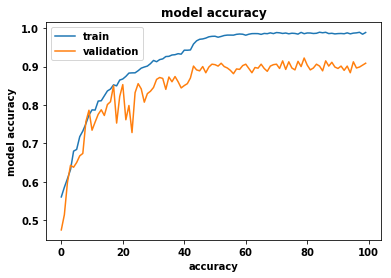

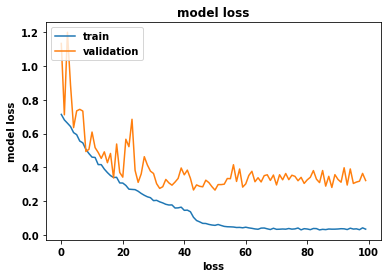

51/51 [==============================] - 8s 159ms/step
Validation loss: 0.30470807233848324
Validation accuracy: 0.9074074074074074
Found 2064 images.
129/129 [==============================] - 11s 87ms/step
unnormalized confusion matrix
[[1012   68]
 [ 120  864]]
              precision    recall  f1-score   support

           1       0.89      0.94      0.92      1080
           2       0.93      0.88      0.90       984

   micro avg       0.91      0.91      0.91      2064
   macro avg       0.91      0.91      0.91      2064
weighted avg       0.91      0.91      0.91      2064



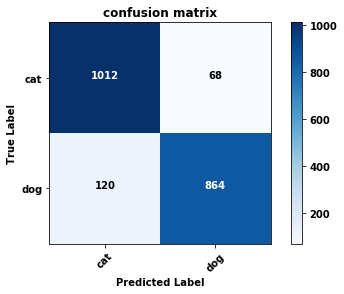

In [39]:
plot_history(xception_plot)
validation_scores(Xception)
prediction_results(Xception)

Another model with 91% accuracy, seems like were are approaching the limit with this dataset. This model also has 20,000,000 trainable parameters, so fiddling with the model to reduce those parameters may yield a better result - for another day

# Ensemble


There are now 2 models that have 91% accuracy, however they both seem to predict cats and dogs differently. If we comobine these 2 models in an ensemble can we boost our performance?

Found 2064 images.
129/129 [==============================] - 11s 87ms/step
Found 2064 images.
129/129 [==============================] - 9s 71ms/step
Found 2064 images.
unnormalized confusion matrix
[[1014   66]
 [  92  892]]
              precision    recall  f1-score   support

           1       0.92      0.94      0.93      1080
           2       0.93      0.91      0.92       984

   micro avg       0.92      0.92      0.92      2064
   macro avg       0.92      0.92      0.92      2064
weighted avg       0.92      0.92      0.92      2064



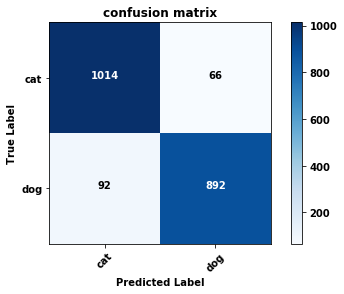

In [42]:
def get_prediction(model):
    test_datagen=ImageDataGenerator(rescale=1./255.)
    # cut off the last 3 rows as it messes 
    # with the predictions due to the batch size not dividing evenly
    test_mod = test[:-3]
    test_generator = test_datagen.flow_from_dataframe(
            test_mod, 
            '../pet_data/train_images/', 
            x_col='filename',
            y_col=None, 
            target_size=(150, 150),
            class_mode=None, 
            color_mode='rgb',
            batch_size=16, 
            shuffle=False,
            seed=2018,
        )

    STEP_SIZE_TEST = test_generator.n//test_generator.batch_size

    test_generator.reset()
    return model.predict_generator(
        test_generator,
        STEP_SIZE_TEST,
        verbose=1
    )
    
def output_preds(preds):
    test_datagen=ImageDataGenerator(rescale=1./255.)
    # cut off the last 3 rows as it messes 
    # with the predictions due to the batch size not dividing evenly
    test_mod = test[:-3]
    test_generator = test_datagen.flow_from_dataframe(
            test_mod, 
            '../pet_data/train_images/', 
            x_col='filename',
            y_col=None, 
            target_size=(150, 150),
            class_mode=None, 
            color_mode='rgb',
            batch_size=16, 
            shuffle=False,
            seed=2018,
        )
    prediction_dict = {'filename': [], 'prediction': []}
    df = pd.DataFrame()

    for index, predict in enumerate(preds):
        filename = test_generator.filenames[index]
        if predict > 0.5:
            prediction_dict['filename'].append(filename) 
            prediction_dict['prediction'].append(2) 
        else: 
            prediction_dict['filename'].append(filename) 
            prediction_dict['prediction'].append(1)

    predictions_df5 = pd.DataFrame(prediction_dict) 

    drop_y_true5 = test_mod.type.astype(int)
    drop_y_pred5 = predictions_df5.prediction

    plot_confusion_matrix(
        confusion_matrix(drop_y_true5, drop_y_pred5),
        ['cat', 'dog']
    )

    report = classification_report(
        drop_y_true5, 
        drop_y_pred5, 
        [1, 2]
    )
    print(report) 

vgg_pred = get_prediction(vgg)
xcept_pred = get_prediction(Xception)

# combine the models predictions in an ensemble
combined_preds = 0.5 * (vgg_pred + xcept_pred)

output_preds(combined_preds)

Low and behold we can, 92% accuracy an excellent result.

# Hyperas model

Out of all the tested architectures, the simple VGG style seems to performs the best (Occam's Razor!). The one thing we haven't invested much time in is hyper-parameter tuning. Rather than manually runnung models and changing them based on feedback, we can use a library.<br><br>Hyperas is a library that works as a wrapper for Keras and lets you find the most suitable parameters for your network

### Design a data template

Hyperas needs a method to load the required data for the model

In [ ]:
def data():
    test_df = pd.read_csv('../pet_data/test/test.csv')
    train_df = pd.read_csv('../pet_data/train.csv')
    train_folder = '../pet_data/train_images/'
    test_folder = '../pet_data/test_images/'
    name_target_dict = train_df.set_index('PetID')['AdoptionSpeed'].to_dict()
    name_target_dict_type = train_df.set_index('PetID')['Type'].to_dict()
    train_image_names = os.listdir('../pet_data/train_images')
    test_image_names = os.listdir('../pet_data/test_images')
    generator_dict = {'filename': [], 'class': [], 'type': []}

    for name in train_image_names:
        short_name = name.split('-')[0]
        label = name_target_dict[short_name]
        t = name_target_dict_type[short_name]

        generator_dict['filename'].append(name)
        generator_dict['class'].append(label)
        generator_dict['type'].append(str(t))
        
    generator_df = pd.DataFrame(generator_dict)
    generator_df.head(8)
    
    random_state = 42
    train, test = train_test_split(generator_df, test_size=0.2, random_state=random_state)
    
    train_datagen=ImageDataGenerator(
        featurewise_center=False,  # set input mean to 0 over the dataset
        samplewise_center=False,  # set each sample mean to 0
        featurewise_std_normalization=False,  # divide inputs by std of the dataset
        samplewise_std_normalization=False,  # divide each input by its std
        zca_whitening=False,  # apply ZCA whitening
        zca_epsilon=1e-06,  # epsilon for ZCA whitening
        rotation_range=15,  # randomly rotate images in the range (degrees, 0 to 180)
        width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
        height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
        shear_range=0.1,  # set range for random shear
        zoom_range=0.1,  # set range for random zoom
        channel_shift_range=0.,  # set range for random channel shifts
        # set mode for filling points outside the input boundaries
        fill_mode='nearest',
        cval=0.,  # value used for fill_mode = "constant"
        horizontal_flip=True,  # randomly flip images
        vertical_flip=False,  # randomly flip images
        # set rescaling factor (applied before any other transformation)
        rescale=1/255.,
        # set function that will be applied on each input
        preprocessing_function=None,
        # fraction of images reserved for validation (strictly between 0 and 1)
        validation_split=0.1
    )
    
    train_generator = train_datagen.flow_from_dataframe(
        train, 
        '../pet_data/train_images/', 
        x_col='filename',
        y_col='type', 
        has_ext=True,  # If image extension is given in x_col
        target_size=(150, 150), 
        color_mode='rgb',
        class_mode='binary', 
        batch_size=16, 
        shuffle=True, 
        seed=2018,
        subset='training'
    )
    valid_generator = train_datagen.flow_from_dataframe(
        train, 
        '../pet_data/train_images/', 
        x_col='filename',
        y_col='type', 
        has_ext=True,  # If image extension is given in x_col
        target_size=(150, 150), 
        color_mode='rgb',
        class_mode='binary', 
        batch_size=16, 
        shuffle=True, 
        seed=2018,
        subset='validation'
    )
    
    return train_generator, valid_generator, train, test

It then needs a method with templates to create the model

In [ ]:
def model(train_generator, valid_generator):
    input_shape=(150, 150, 3)
    # hyperparameters are wrapped in double curly braces
    # with the distrobution of values to use in the algorithm
    ks1_first = {{choice([2, 3, 4, 5, 8, 10])}}
    ks1_second = {{choice([2, 3, 4, 5, 8, 10])}}
    
    ks2_first = {{choice([2, 3, 4, 5, 8, 10])}}
    ks2_second = {{choice([2, 3, 4, 5, 8, 10])}}
    pool = {{choice([2, 4])}}
    
    
    model = models.Sequential()
    
    # this is the same VGG model as before, but now with parameter
    # substitution
    model.add(Conv2D(filters=( {{choice([32, 64, 128])}} ), 
                                    kernel_size=(ks1_first, ks1_second), 
                                    activation='relu', 
                                    input_shape=input_shape, 
                                    padding='same'))
    model.add(Conv2D(filters=( {{choice([32, 64, 128])}} ),
                                     kernel_size=(ks1_first, ks1_second),
                                     activation='relu', 
                                     padding='same'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool, pool))

    model.add(Conv2D(filters=( {{choice([64, 128, 256])}} ),
                                     kernel_size=(ks2_first, ks2_second),
                                     activation='relu', 
                                     padding='same'))
    model.add(Conv2D(filters=( {{choice([64, 128, 256])}}) ,
                                     kernel_size=(ks2_first, ks2_second),
                                     activation='relu', 
                                     padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.MaxPooling2D(pool, pool))

    model.add(Conv2D(filters=( {{choice([32, 64, 128])}}) ,
                                     kernel_size=(ks2_first, ks2_second),
                                     activation='relu', 
                                     padding='same'))
    model.add(Conv2D(filters=( {{choice([32, 64, 128])}}) ,
                                     kernel_size=(ks2_first, ks2_second),
                                     activation='relu', 
                                     padding='same'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool, pool))

    model.add(Flatten())
    model.add(Dropout( {{uniform(0, 1)}} ))
    model.add(Dense ({{choice([32, 64, 128, 256, 512, 1024, 2048, 4096])}} ,
                            activation='relu'))
    model.add(BatchNormalization())

    model.add(Dense(1, activation='sigmoid'))

    model.compile(loss='binary_crossentropy',
                  optimizer={{choice([
                      optimizers.RMSprop(lr=1e-4),
                      'rmsprop',
                      'adam',
                      'adadelta',
                      'adagrad',
                      'nadam'
                  ])}},
                  metrics=['acc'])
              
    callbacks_list = [
        ModelCheckpoint (
            filepath='best.h5', 
            monitor='val_loss', 
            verbose=0, 
            save_best_only=True, 
            save_weights_only=False,
            mode='auto',
        ),
        EarlyStopping (
            monitor='val_acc',
            verbose=1,
            min_delta=0.01,
            patience=10,
        ),
        ReduceLROnPlateau (
            monitor='val_loss',
            factor=0.1,
            verbose=1,
            cooldown=4,
            patience=10,
        ),
        TensorBoard (
            log_dir='my_log_dir',
            embeddings_freq=0,
            write_graph=True
        ),
    ]
                  
    checkpoint = ModelCheckpoint(
        'vgg_with_hyperas.h5', 
        monitor='val_acc', 
        verbose=0, 
        save_best_only=True, 
        save_weights_only=False,
        mode='auto'
    )

    STEP_SIZE_TRAIN = train_generator.n//train_generator.batch_size
    STEP_SIZE_VALID = valid_generator.n//valid_generator.batch_size

    result = model.fit_generator(
        train_generator,
        steps_per_epoch=STEP_SIZE_TRAIN, 
        epochs=100,
        validation_data=valid_generator,
        validation_steps=STEP_SIZE_VALID,
        callbacks=callbacks_list,
        verbose=0
    )
    
    val_acc = np.amin(result.history['val_acc'])
    print('Best validation accuracy of epoch:', val_acc)
    # this tells hyperas that we want to maximize our validation acc
    return {'loss': -val_acc, 'status': STATUS_OK, 'model': model}

Then the data and the model functions are passed to the minimize function defined by hyperas

In [ ]:
best_run, best_model = optim.minimize(
    model=model, 
    data=data,
    algo=tpe.suggest,
    max_evals=10,
    eval_space=True,
    trials=Trials(),
    notebook_name='Presentation notebook'
)
    
X_train, y_train, X_test, y_test = data()
print("Evalutation of best performing model:")
# print(best_model.evaluate(valid))

print("Crossvalidation of best performing model:")
#print(best_model.evaluate(X_test, y_test))

print("Best performing model chosen hyper-parameters:")
print(best_run)

Hyperas search space:

def get_space():
    return {
        'ks1_first': hp.choice('ks1_first', [2, 3, 4, 5, 8, 10]),
        'ks1_first_1': hp.choice('ks1_first_1', [2, 3, 4, 5, 8, 10]),
        'ks1_first_2': hp.choice('ks1_first_2', [2, 3, 4, 5, 8, 10]),
        'ks1_first_3': hp.choice('ks1_first_3', [2, 3, 4, 5, 8, 10]),
        'pool': hp.choice('pool', [2, 4]),
        'pool_1': hp.choice('pool_1', [32, 64, 128]),
        'pool_2': hp.choice('pool_2', [32, 64, 128]),
        'pool_3': hp.choice('pool_3', [64, 128, 256]),
        'pool_4': hp.choice('pool_4', [64, 128, 256]),
        'pool_5': hp.choice('pool_5', [32, 64, 128]),
        'pool_6': hp.choice('pool_6', [32, 64, 128]),
        'Dropout': hp.uniform('Dropout', 0, 1),
        'Dense': hp.choice('Dense', [32, 64, 128, 256, 512, 1024, 2048, 4096]),
        'optimizer': hp.choice('optimizer', [
                      optimizers.RMSprop(lr=1e-4),
                      'rmsprop',
                      'adam',
                      'adadelta',
                      'adagrad',
                      'nadam'
                  ]),
    }

Found 826 images belonging to 2 classes.
                                                    
Epoch 00023: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
Epoch 00023: early stopping                         
Best validation accuracy of epoch:                  
0.4691358027634797                                  
Epoch 00047: early stopping                                                       
Best validation accuracy of epoch:                                                  
0.5839506175782946                                                                  
Epoch 00058: early stopping                                                         
Best validation accuracy of epoch:                                                  
0.4654320987654321                                                                  
Epoch 00052: early stopping                                                         
Best validation accuracy of epoch:                                                  
0.5419753087891472                                                                  
                                                                                    
Epoch 00051: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
Epoch 00063: early stopping                                                         
Best validation accuracy of epoch:                                                  
0.4851851854795291                                                                  
Epoch 00047: early stopping                                                         
Best validation accuracy of epoch:                                                  
0.528395062022739                                                                   
Epoch 00042: early stopping                                                         
Best validation accuracy of epoch:                                                   
0.48024691387459084                                                                  
                                                                                     
Epoch 00017: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
Epoch 00017: early stopping                                                          
Best validation accuracy of epoch:                                                   
0.517283950654077                                                                    
Epoch 00051: early stopping                                                          
Best validation accuracy of epoch:                                                   
0.46913580232196384                                                                  
                                                                                      
Epoch 00058: ReduceLROnPlateau reducing learning rate to 0.1.
Epoch 00058: early stopping                                                           
Best validation accuracy of epoch:                                                    
0.47037037044395635                                                                   
100%|██████████| 10/10 [23:08:58<00:00, 12644.47s/it, best loss: -0.5839506175782946] 
Found 7438 images belonging to 2 classes.
Found 826 images belonging to 2 classes.
Evalutation of best performing model:
Crossvalidation of best performing model:
Best performing model chosen hyper-parameters:

{'Dense': 1024, 'Dropout': 0.4970559482092457, 'ks1_first': 5, 'ks1_first_1': 2, 'ks1_first_2': 5, 'ks1_first_3': 3, 'optimizer': 'adadelta', 'pool': 2, 'pool_1': 64, 'pool_2': 128, 'pool_3': 64, 'pool_4': 128, 'pool_5': 128, 'pool_6': 32}

(after 30 hours of searching)
At the end of its output we can see the hyperparameters it came up with, lets pass these parameters to our model design

In [19]:
input_shape=(150, 150, 3)

hyperas_model = models.Sequential()

hyperas_model.add(Conv2D(filters=(64), 
                                    kernel_size=(5, 2), 
                                    activation='relu', 
                                    input_shape=input_shape, 
                                    padding='same'))
hyperas_model.add(Conv2D(filters=(128),
                                 kernel_size=(5, 2),
                                 activation='relu', 
                                 padding='same'))
hyperas_model.add(BatchNormalization())
hyperas_model.add(MaxPooling2D(2, 2))


hyperas_model.add(Conv2D(filters=(64),
                                 kernel_size=(5, 3),
                                 activation='relu', 
                                 padding='same'))
hyperas_model.add(Conv2D(filters=(128) ,
                                 kernel_size=(5, 3),
                                 activation='relu', 
                                 padding='same'))
hyperas_model.add(layers.BatchNormalization())
hyperas_model.add(layers.MaxPooling2D(2, 2))

hyperas_model.add(Conv2D(filters=(128) ,
                                 kernel_size=(5, 3),
                                 activation='relu', 
                                 padding='same'))
hyperas_model.add(Conv2D(filters=(32) ,
                                 kernel_size=(5, 3),
                                 activation='relu', 
                                 padding='same'))
hyperas_model.add(BatchNormalization())
hyperas_model.add(MaxPooling2D(2, 2))

hyperas_model.add(Flatten())
hyperas_model.add(layers.Dropout(0.4970559482092457))
hyperas_model.add(layers.Dense(1024, activation='relu'))
hyperas_model.add(layers.BatchNormalization())

hyperas_model.add(layers.Dense(1, activation='sigmoid'))

hyperas_model.compile(loss='binary_crossentropy',
              optimizer='adadelta',
              metrics=['acc'])

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


In [22]:
hyperas_model_plot = fit_model(hyperas_model, 'hyperas_model', 100)



Epoch 00042: ReduceLROnPlateau reducing learning rate to 0.1.

Epoch 00056: ReduceLROnPlateau reducing learning rate to 0.010000000149011612.

Epoch 00078: ReduceLROnPlateau reducing learning rate to 0.0009999999776482583.

Epoch 00098: ReduceLROnPlateau reducing learning rate to 9.999999310821295e-05.


TypeError: 'History' object is not subscriptable

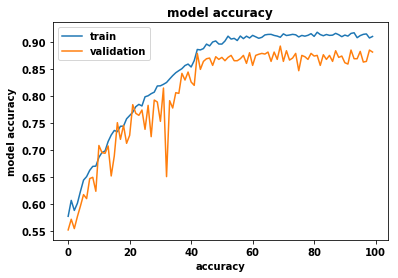

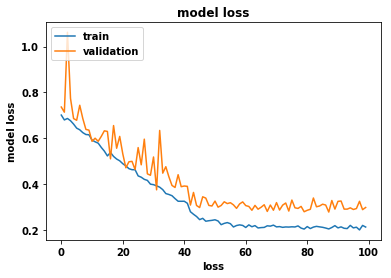

51/51 [==============================] - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - 8s 158ms/step
Validation loss: 0.29163061483406727
Validation accuracy: 0.8802469137274189
Found 2064 images.
129/129 [==============================] - ETA: 14 - ETA: 12 - ETA: 11 - ETA: 10 - ETA: 10 - ETA: 9 - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA

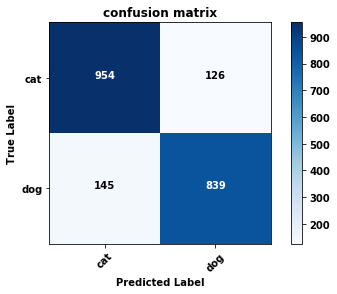

In [28]:
plot_history(hyperas_model_plot)
validation_scores(hyperas_model)
prediction_results(hyperas_model)

After all that waiting our results are not better. This does not mean the library is useless however, just the time and resources required to search is not available during this project.

# Balance our data

Since our dataset is slightly imbalanced with may use subsampling to even it out. We cant oversample because we dont want to duplicate images

In [ ]:
train.groupby('type').size()

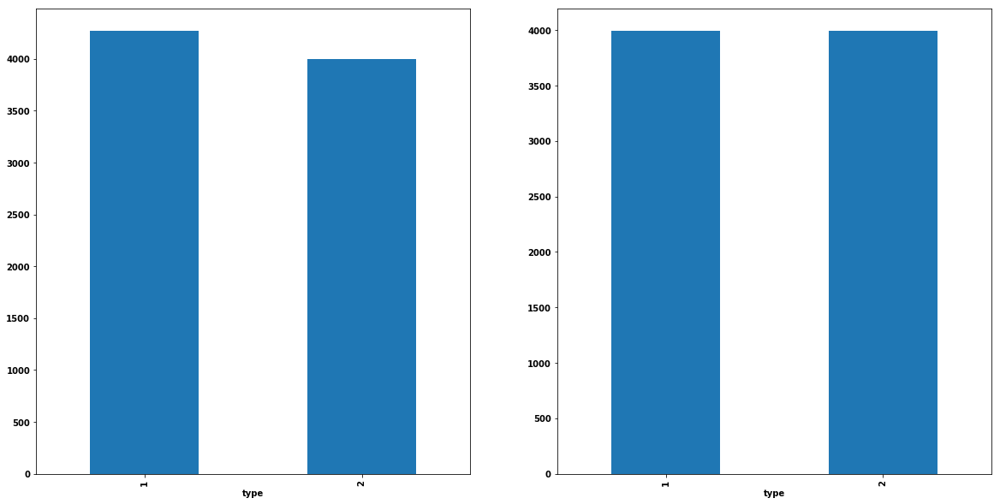

In [250]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (20, 10))
train.groupby('type').size().plot.bar(ax=ax1)
train_subsampled = train.groupby('type').apply(lambda x: x.sample((3994*2)//2, replace=False)).reset_index(drop=True)
train_subsampled.groupby('type').size().plot.bar(ax=ax2)

In [251]:
train_subsampled.groupby('type').size()

type
1    3994
2    3994
dtype: int64

In [256]:
# creating a training generator
train_datagen_subbed=ImageDataGenerator(
    rescale=1/255.,# scale the pixel values
    validation_split=0.1, # set aside 10% of the training set for validation
    featurewise_center=False,  # set input mean to 0 over the dataset
    samplewise_center=False,  # set each sample mean to 0
    featurewise_std_normalization=False,  # divide inputs by std of the dataset
    samplewise_std_normalization=False,  # divide each input by its std
    zca_whitening=False,  # apply ZCA whitening
    zca_epsilon=1e-06,  # epsilon for ZCA whitening
    rotation_range=15,  # randomly rotate images in the range (degrees, 0 to 180)
    width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
    height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
    shear_range=0.1,  # set range for random shear
    zoom_range=0.1,  # set range for random zoom
    channel_shift_range=0.,  # set range for random channel shifts
    # set mode for filling points outside the input boundaries
    fill_mode='nearest',
    cval=0.,  # value used for fill_mode = "constant"
    horizontal_flip=True,  # randomly flip images
    vertical_flip=False,
    # set function that will be applied on each input
    preprocessing_function=None
)

# since we dont have our images sorted into nice folders based
# on whether they are cats or dogs, we need to use a brand new feaure
# in keras (flow_from_dataframe).
# this takes an image name from a dataframe and maps it to an image 
# in a specified folder
def create_generator_subbed(subset):
    return train_datagen_subbed.flow_from_dataframe(
        train_subsampled, # the dataframe to get the image name
        '../pet_data/train_images/', # the folder with images
        x_col='filename', # the image to pass to the network
        y_col='type', # the label for an image i.e. cat or dog (1 or 2)
        has_ext=True,  # If image extension is given in x_col
        target_size=(150, 150), # we want to reduce the images to 150 X 150
        color_mode='rgb',
        class_mode='binary', # this will be a binary classification
        batch_size=16, # the batch size to pass to the network
        shuffle=True, 
        seed=2018,
        subset=subset# either training or validation in this case
    )

train_generator_subbed = create_generator_subbed('training')
valid_generator_subbed = create_generator_subbed('validation')

STEP_SIZE_TRAIN_SUB = train_generator_subbed.n//train_generator_subbed.batch_size
STEP_SIZE_VALID_SUB = valid_generator_subbed.n//valid_generator_subbed.batch_size

Found 7190 images belonging to 2 classes.
Found 798 images belonging to 2 classes.


In [257]:
vgg_sub = models.Sequential()

vgg_sub.add(layers.Conv2D(64, (3, 3), activation='relu', 
                      input_shape=(150, 150, 3), padding='same'))
vgg_sub.add(layers.Conv2D(64, (3, 3), activation='relu', padding='same'))
vgg_sub.add(layers.BatchNormalization()) 
vgg_sub.add(layers.MaxPooling2D((2, 2)))

vgg_sub.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
vgg_sub.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
vgg_sub.add(layers.BatchNormalization())
vgg_sub.add(layers.MaxPooling2D((2, 2)))

vgg_sub.add(layers.Conv2D(256, (3, 3), activation='relu', padding='same'))
vgg_sub.add(layers.Conv2D(256, (3, 3), activation='relu', padding='same'))
vgg_sub.add(layers.BatchNormalization())
vgg_sub.add(layers.MaxPooling2D((2, 2)))

vgg_sub.add(layers.Flatten())
vgg_sub.add(layers.Dropout(0.5))
vgg_sub.add(layers.Dense(256, activation='relu'))
vgg_sub.add(layers.BatchNormalization())

vgg_sub.add(layers.Dense(1, activation='sigmoid'))

vgg_sub.compile(loss='binary_crossentropy',
              optimizer='Adam',
              metrics=['acc'])

In [259]:

callbacks_list_sub = [
    ModelCheckpoint (
        filepath='subbed_model.h5', 
        monitor='val_loss', 
        verbose=0, 
        save_best_only=True, 
        save_weights_only=False,
        mode='auto',),
    ReduceLROnPlateau (
        monitor='val_loss',
        factor=0.1,
        verbose=1,
        cooldown=4,
        patience=10,
    ),
    TQDMNotebookCallback(leave_inner=True, leave_outer=True)
]


STEP_SIZE_TRAIN_SUB = train_generator_subbed.n//train_generator_subbed.batch_size
STEP_SIZE_VALID_SUB = valid_generator_subbed.n//valid_generator_subbed.batch_size

# this will return the model history to be graphed
hist_sub = vgg_sub.fit_generator(
    train_generator_subbed,
    steps_per_epoch=STEP_SIZE_TRAIN_SUB, 
    epochs=1,
    callbacks=callbacks_list_sub,
    validation_data=valid_generator_subbed,
    validation_steps=STEP_SIZE_VALID_SUB,
    verbose=0
)

51/51 [==============================] - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - 6s 109ms/step
Validation loss: 0.29229532591268126
Validation accuracy: 0.8848039215686274
Found 2064 images.
129/129 [==============================] - ETA: 17 - ETA: 16 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 1

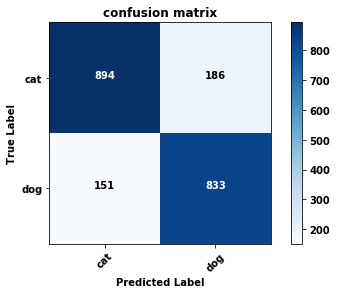

In [263]:
validation_scores(vgg_sub)
prediction_results(vgg_sub)

Decrease in performance due to less data and the classes being more even

# What do our networks actually see and learn?

There have been numerous techniques developed to helpus see what convnets learns such as visualising outputs, filters and viewing heatmaps of class activations in an image

### Intermediate activation function visualization

plotting the activations requires displaying the feature maps of the outputs of convolutions and pooling layers in a network, when they are given an input. This shows how an input is interpreted by different filters in the convolutional layers. 

In [4]:
from keras.models import load_model
vgg_best = load_model('my_vgg3.h5')
vgg_best.summary()

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
Instructions for updating:
Use tf.cast instead.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_27 (Conv2D)           (None, 150, 150, 64)      1792      
_________________________________________________________________
conv2d_28 (Conv2D)           (None, 150, 150, 64)      36928     
_________________________________________________________________
batch_normalization_29 (Batc (None, 150, 150, 64)      256       
_________________________________________________________________
max_pooling2d_15 (MaxPooling (None, 75, 75, 64)        0         
_________________________________________________________________
conv2d_29 (Conv2D)           (None, 75, 75, 128)       73856     
_______________________________________

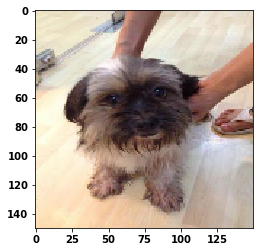

In [272]:
# image cannot be from training set
img_path = '../pet_data/train_images/bfed6fcaa-1.jpg'

img = image.load_img(img_path, target_size=(150, 150)) 
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0) 
img_tensor /= 255.
plt.imshow(img_tensor[0])
plt.show()

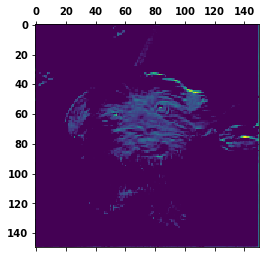

In [273]:
layer_outputs = [layer.output for layer in vgg_best.layers[:12]] 
activation_model = Model(inputs=vgg_best.input, outputs=layer_outputs)

activations = activation_model.predict(img_tensor)

first_layer_activation = activations[0]

plt.matshow(first_layer_activation[0, :, :, 15], cmap='viridis')

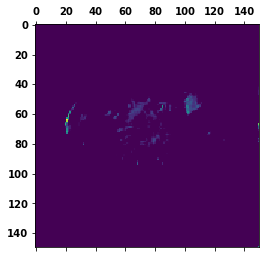

In [303]:

plt.matshow(first_layer_activation[0, :, :, 26], cmap='viridis')

C:\Users\darre\Anaconda3\envs\project_new\lib\site-packages\ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
C:\Users\darre\Anaconda3\envs\project_new\lib\site-packages\ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide


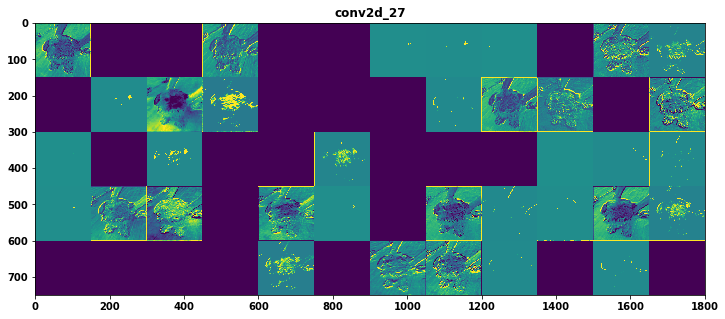

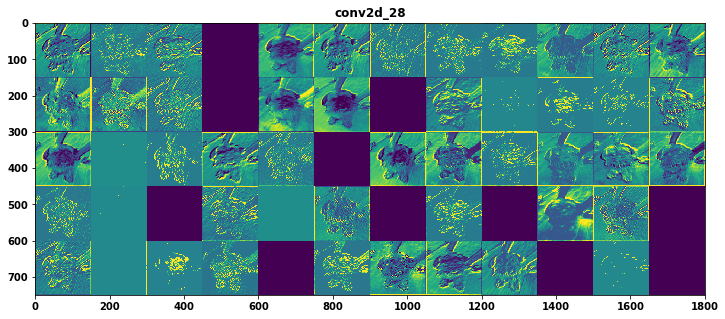

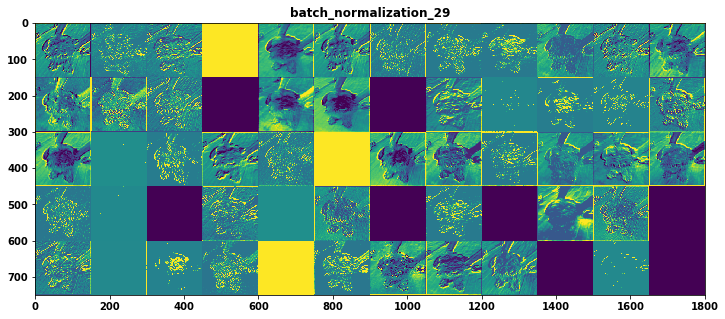

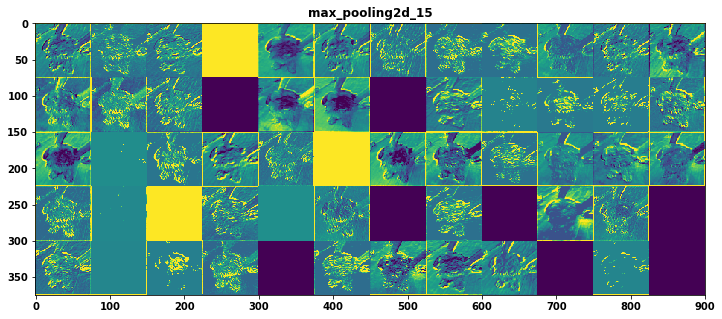

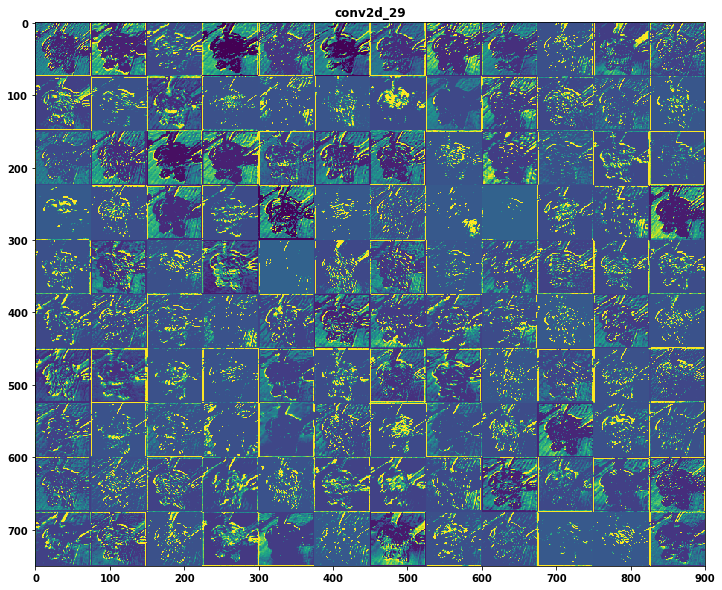

...

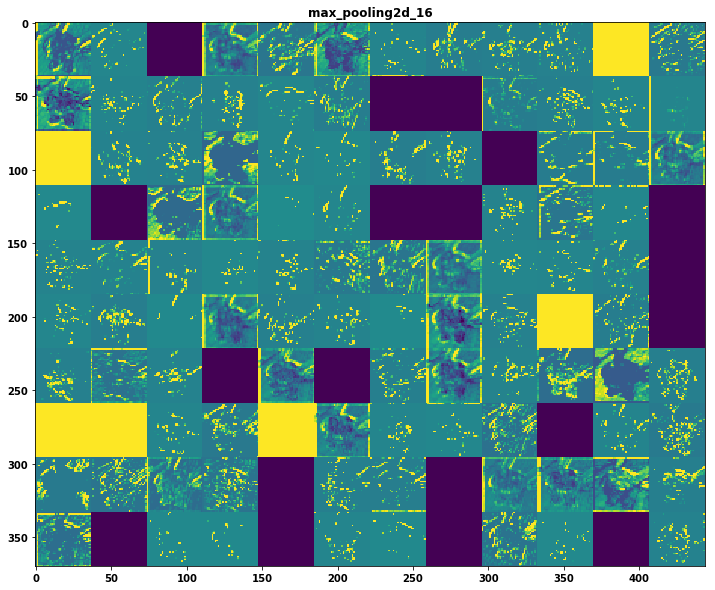

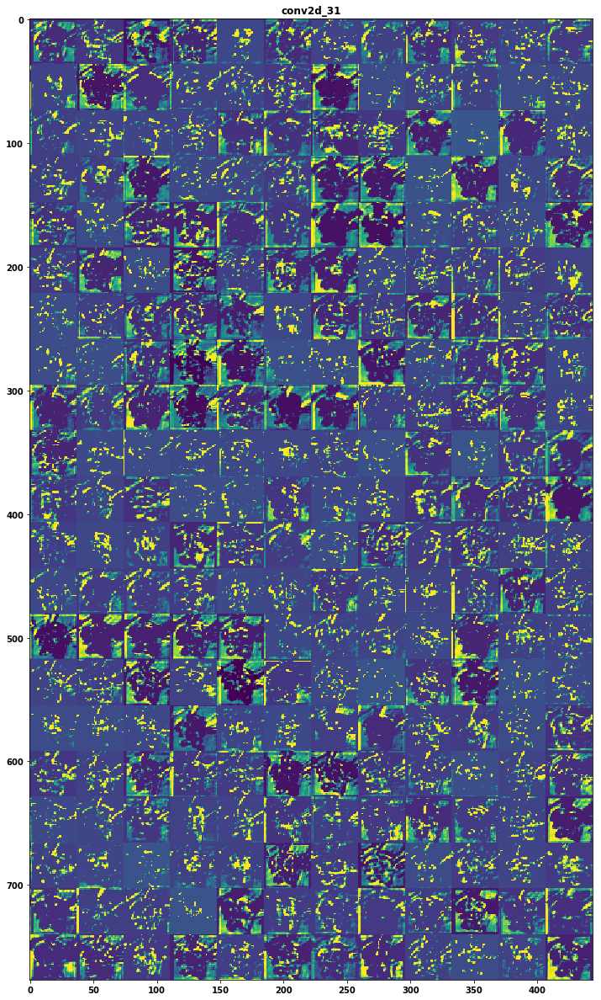

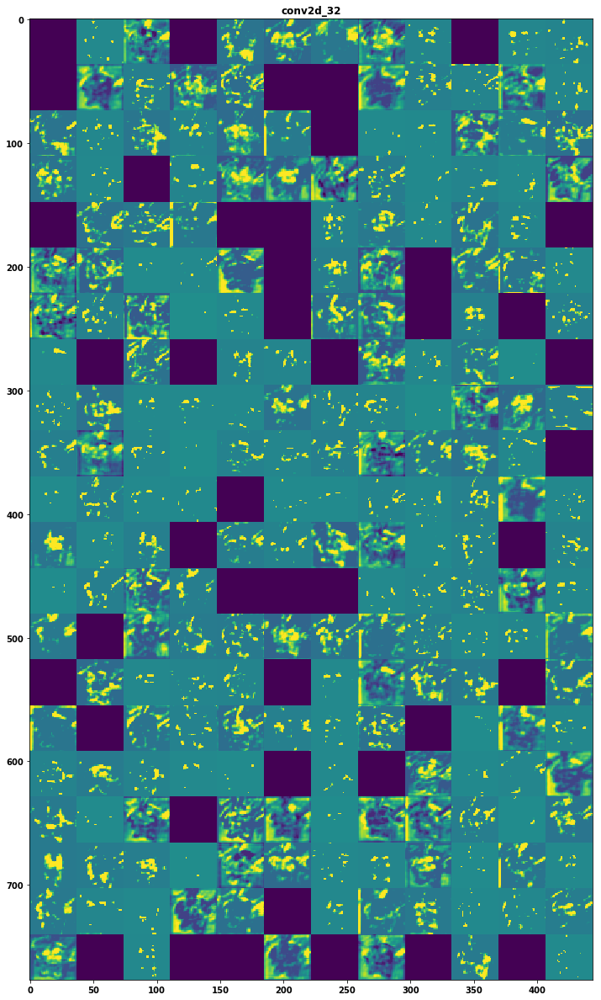

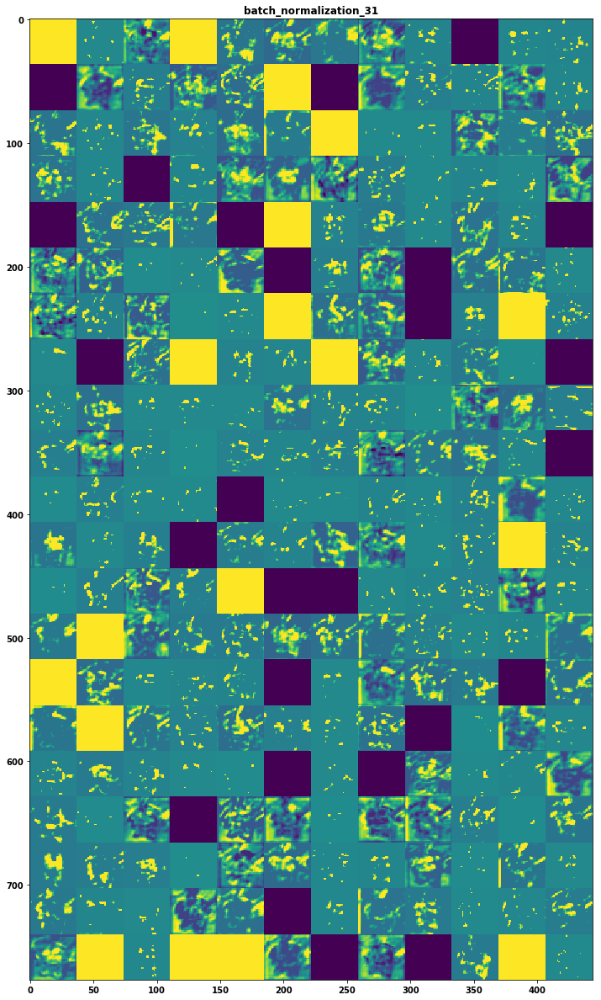

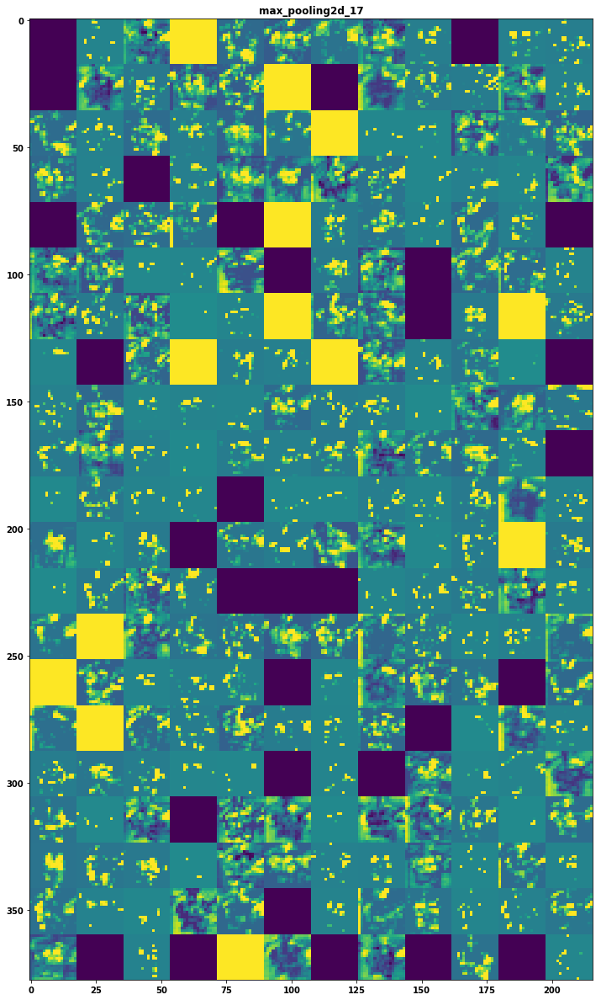

In [275]:
layer_names = []
for layer in vgg_best.layers[:12]:
    layer_names.append(layer.name)

images_per_row = 12

for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]

    size = layer_activation.shape[1]

    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()

### Whats in the networks filters 

We can use gradient ascent from the input space to visualise the patterns leanred by subsequent layers in the convnet. we can display the patterns that the filters are meant to respond to, such as curves or straight lines. 

In [129]:
layer_name = 'conv2d_29'
filter_index = 0

layer_output = vgg_best.get_layer(layer_name).output
loss = K.mean(layer_output[:, :, :, filter_index])
grads = K.gradients(loss, vgg_best.input)[0]
grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

iterate = K.function([vgg_best.input], [loss, grads])
loss_value, grads_value = iterate([np.zeros((1, 150, 150, 3))])


In [135]:
def deprocess_image(x):
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1
    
    x += 0.5
    x = np.clip(x, 0, 1)
    
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [164]:
def generate_pattern(layer_name, filter_index, size=150):
    layer_output = vgg_best.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])
    grads = K.gradients(loss, vgg_best.input)[0]
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)
    iterate = K.function([vgg_best.input], [loss, grads])
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        
    img = input_img_data[0]
    return deprocess_image(img)

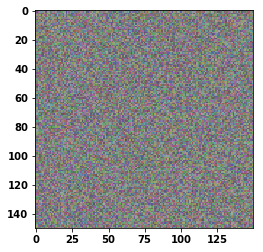

In [171]:
plt.imshow(generate_pattern('conv2d_27', 5))

In [175]:
def show_filter_grid(layer_name):
    size = 64
    margin = 5

    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

    for i in range(8):  
        for j in range(8): 
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)

            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, 
                    vertical_start: vertical_end, :] = filter_img

    plt.figure(figsize=(20, 20))
    plt.imshow(results.astype('uint8'))
    plt.show()

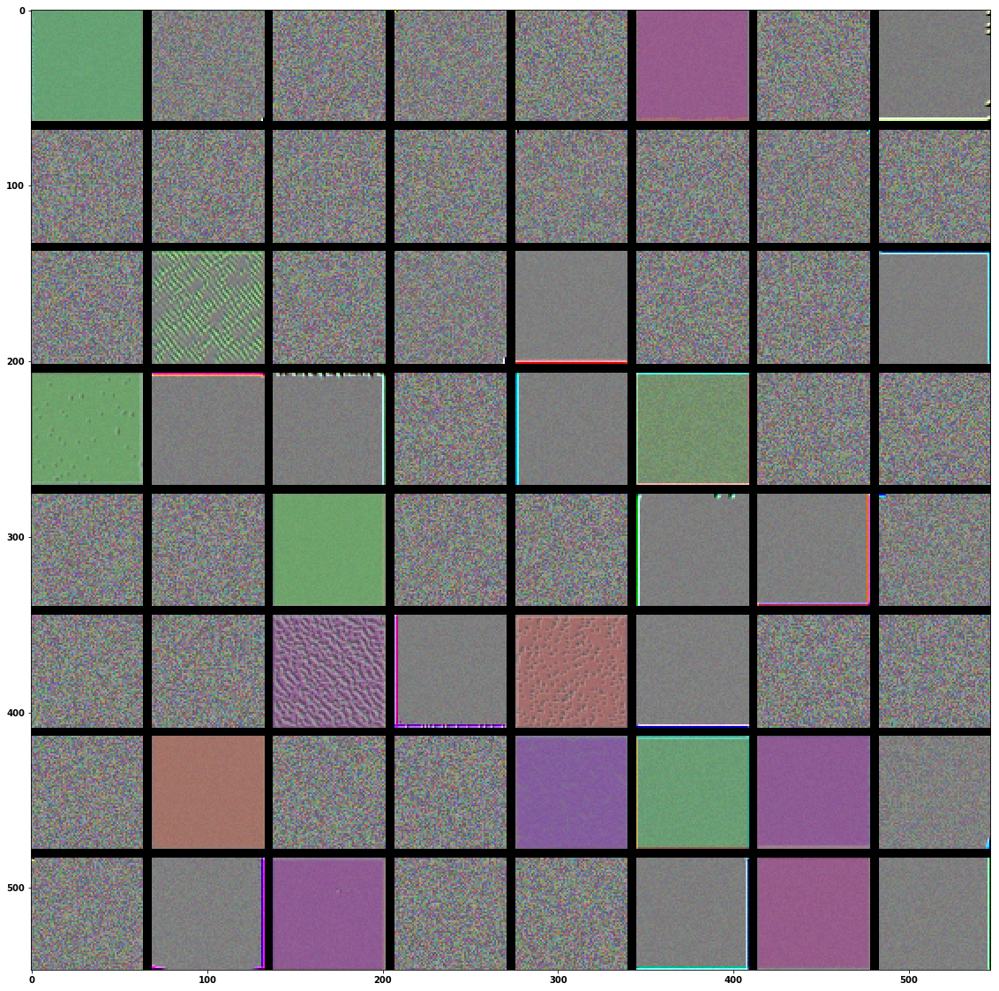

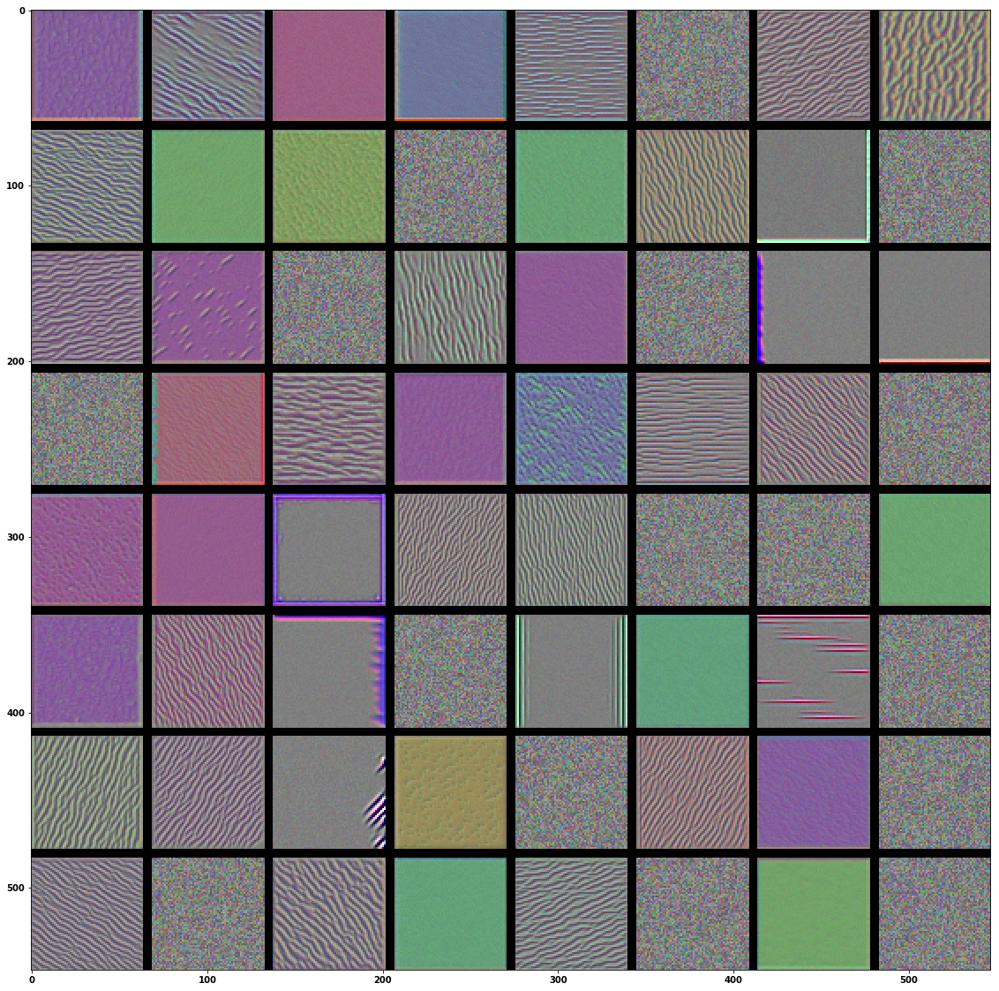

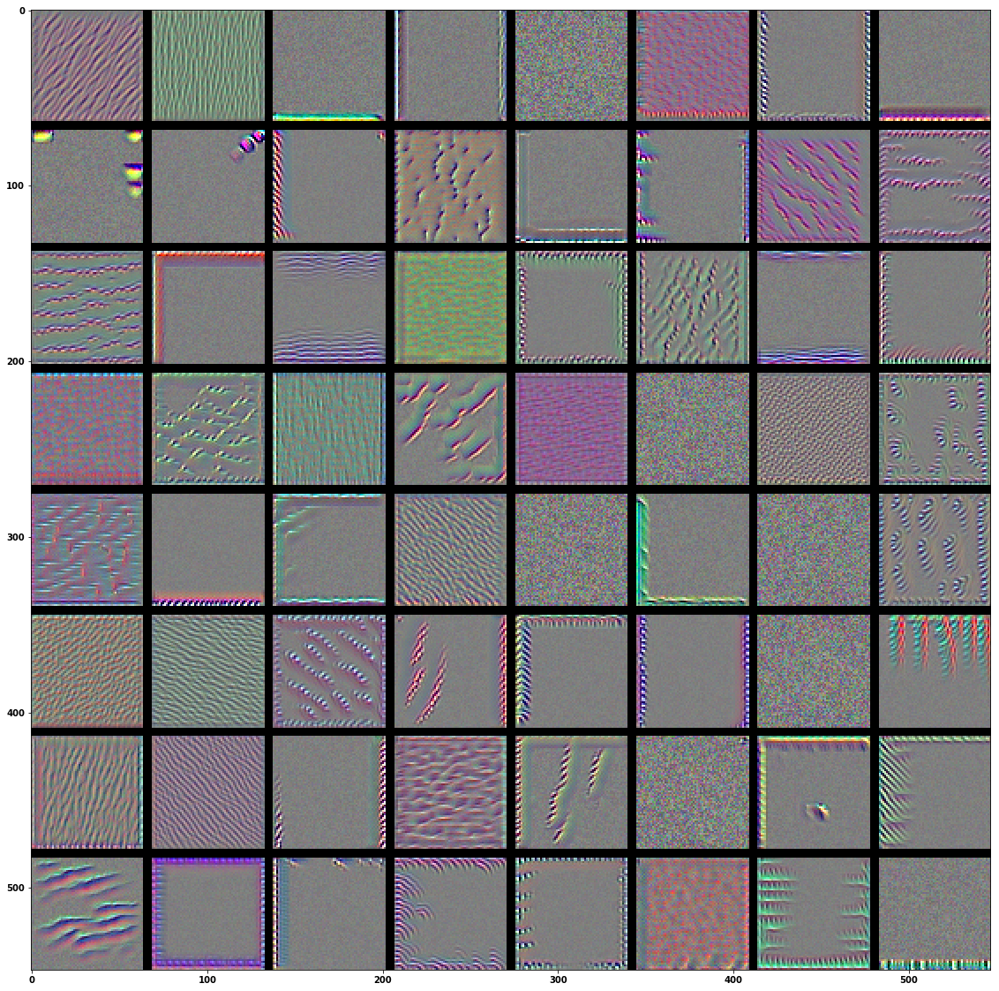

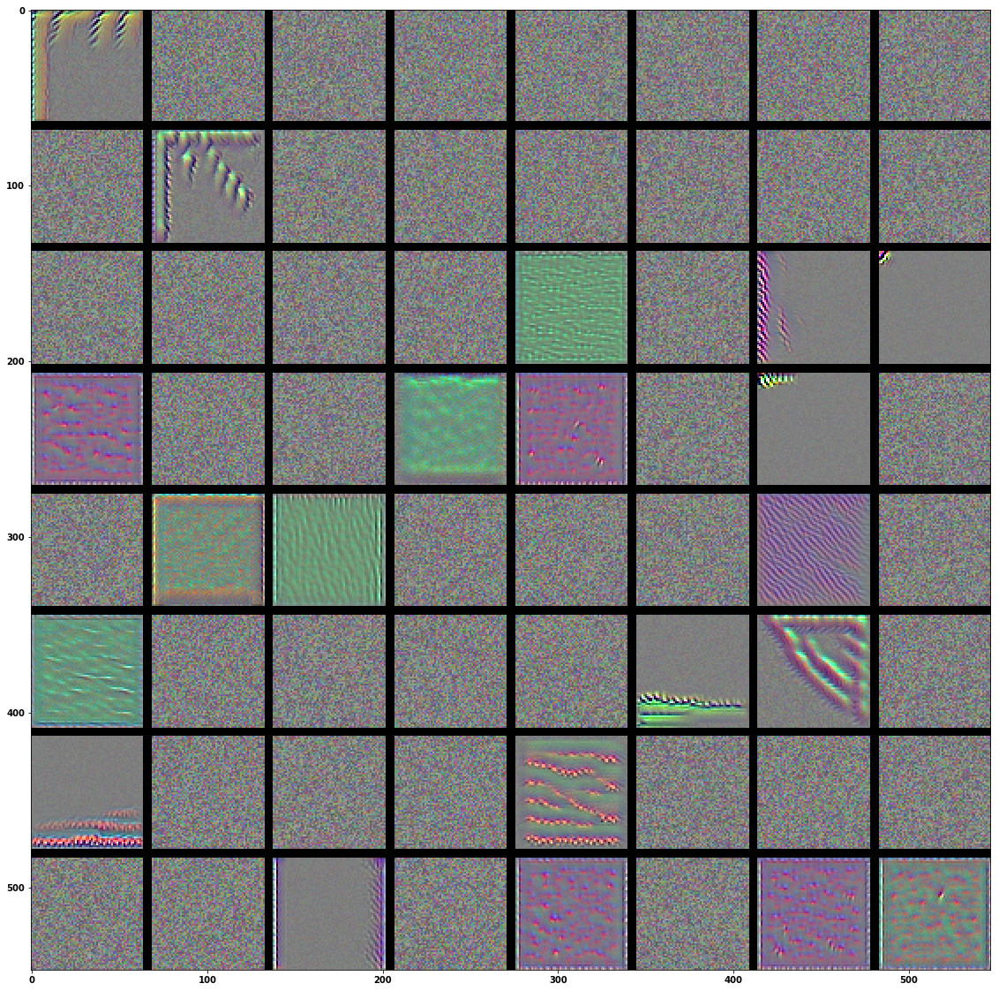

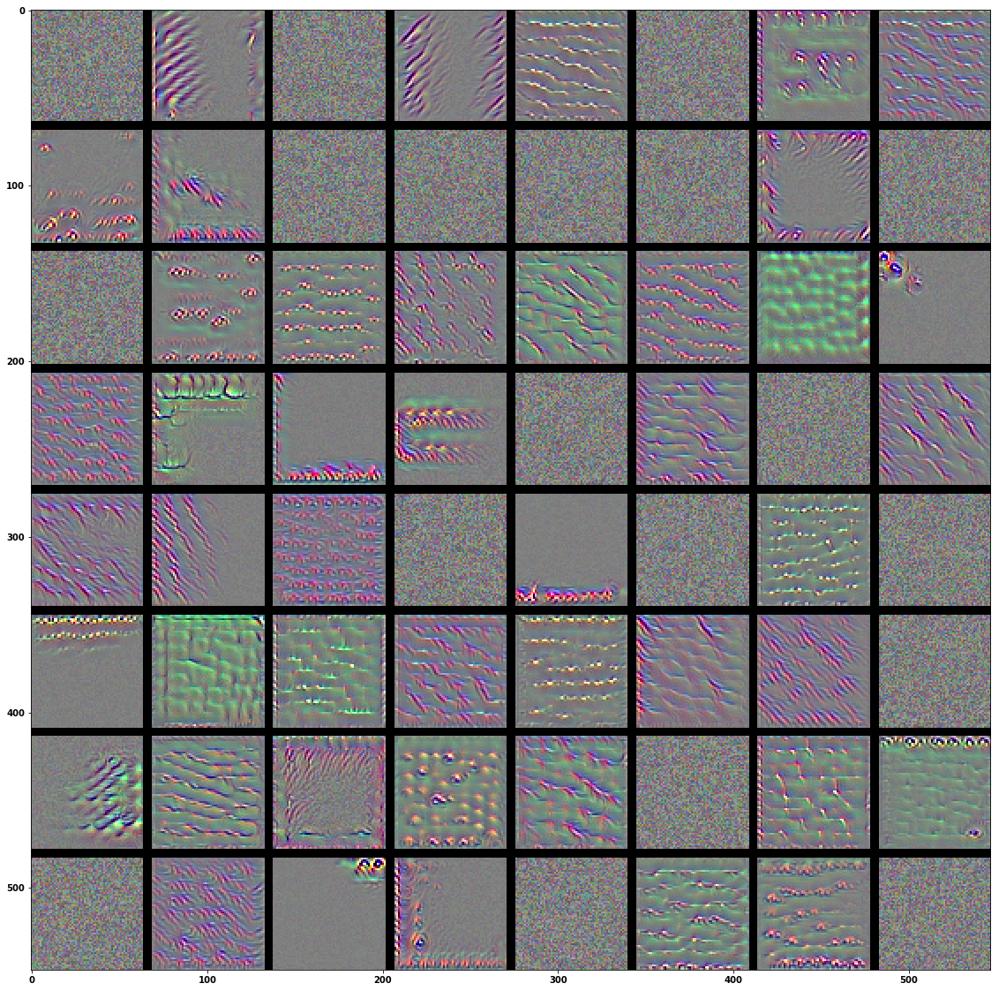

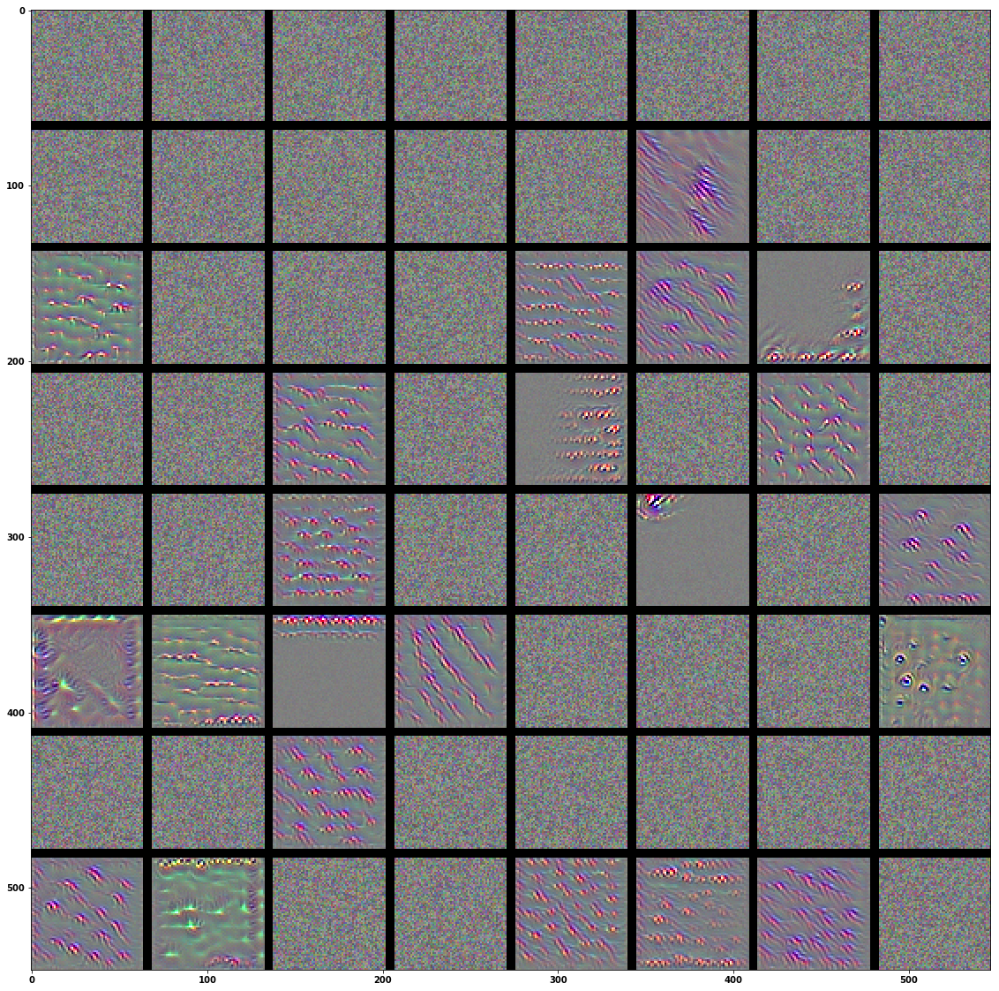

In [174]:
for layer_name in [
    'conv2d_27', 'conv2d_28', 
    'conv2d_29', 'conv2d_30',
    'conv2d_31', 'conv2d_32']:
    show_filter_grid(layer_name)

These visualizations show how different convnet filters see reality. Each filter picks up on a different pattern

### Heatmaps of class activations 

This technique shows which part of the image determines the class the image belongs to. I highlights the part of the image that are of importance to the network making its decision. This technique is also called a Class Activation Map. 

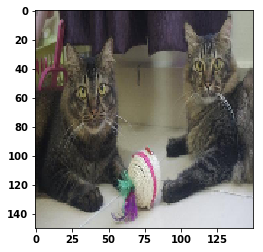

In [333]:
from keras.applications.imagenet_utils import preprocess_input

img_path2 = '../pet_data/train_images/8f476ed34-2.jpg'
img_path3 = '../pet_data/train_images/19db3e21f-2.jpg'
img_path4 = '../pet_data/train_images/72e76bc9b-3.jpg'
img_path5 = '../pet_data/train_images/92ee6241d-7.jpg'
img_path6 = '../pet_data/train_images/105c00abe-4.jpg'
img_path7 = '../pet_data/train_images/7b0d325d8-9.jpg'

img = image.load_img(img_path2, target_size=(150, 150)) 
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0) 
img_tensor /= 255.
plt.imshow(img_tensor[0])
plt.show()


In [334]:
preds = vgg_best.predict(img_tensor)

In [335]:
preds.argmax(axis=-1)

array([0], dtype=int64)

It predicts a cat

In [336]:
two_cat_output = vgg_best.output[:, 0]
last_conv_layer = vgg_best.get_layer('conv2d_32')

grads = K.gradients(two_cat_output, last_conv_layer.output)[0]
pooled_grads = K.mean(grads, axis=(0, 1, 2))

iterate = K.function([vgg_best.input],
                     [pooled_grads, last_conv_layer.output[0]])
pooled_grads_value, conv_layer_output_value = iterate([img_tensor])
for i in range(256):
    conv_layer_output_value[:, :, i] *= pooled_grads_value[i]
    
heatmap = np.mean(conv_layer_output_value, axis=-1)

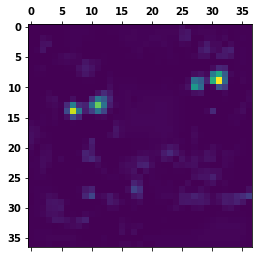

In [337]:
heatmap = np.maximum(heatmap, 0)
heatmap /= np.max(heatmap)
plt.matshow(heatmap)

Here we visualise the parts of the image that are most like cats in a heatmap

In [332]:
import cv2
img = cv2.imread(img_path7)
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img
# cv2.imwrite('./threepups.jpg', superimposed_img)

True

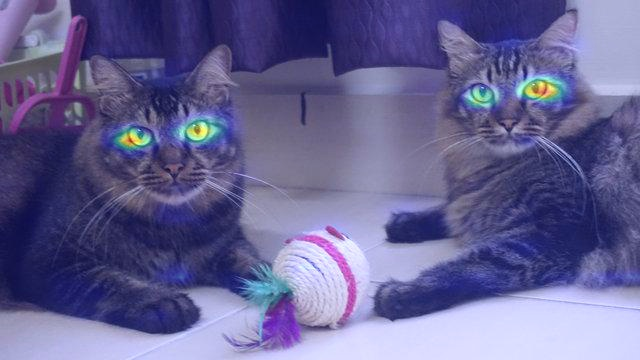

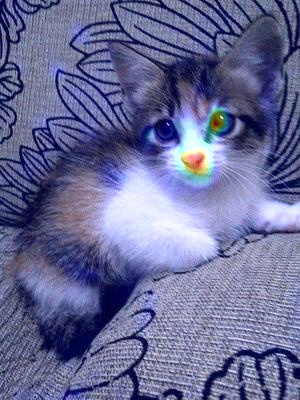

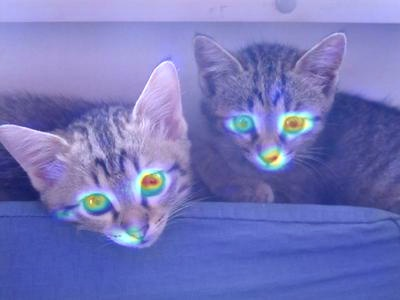

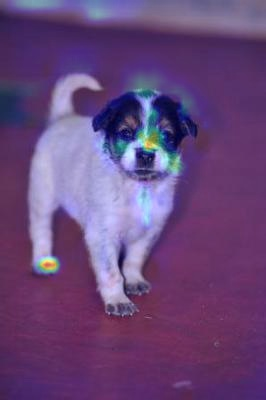

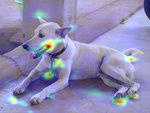

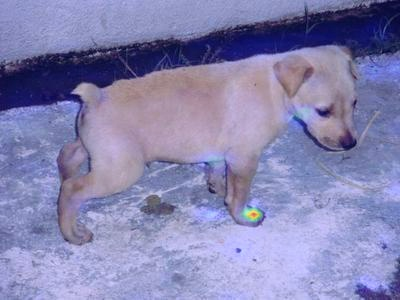

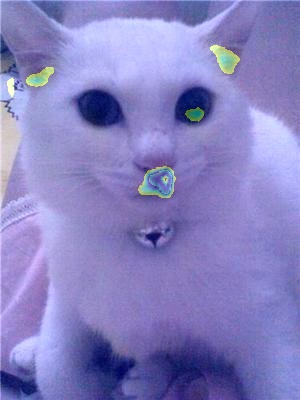

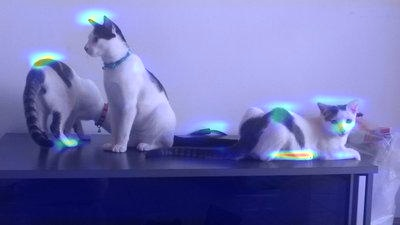

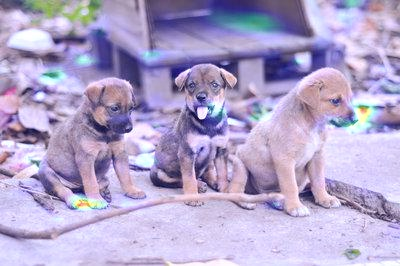

Looks lke it nkows cats by their eyes and nose, and dogs by their paws

# Lets see the images that are being predicted

Found 2064 images.
Found 2064 images.


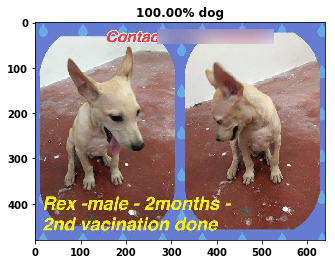

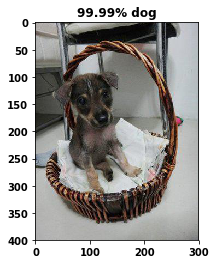

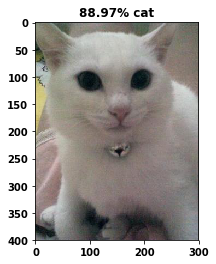

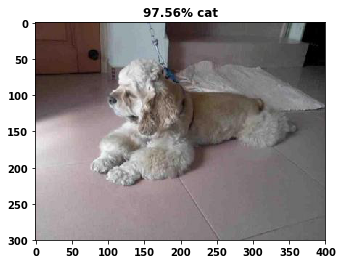

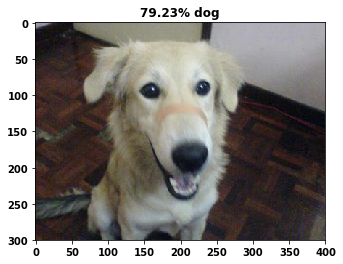

...

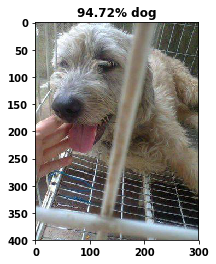

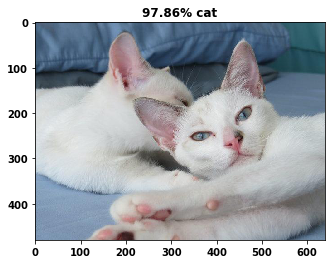

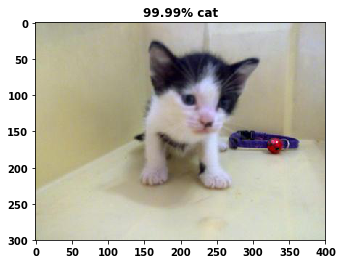

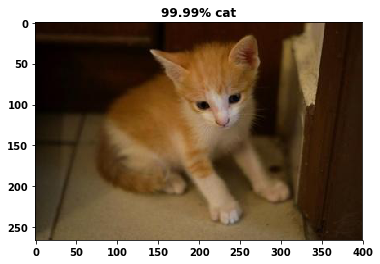

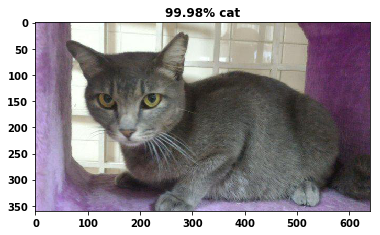

KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

In [208]:
def get_prediction(model):
    test_datagen=ImageDataGenerator(rescale=1./255.)
    # cut off the last 3 rows as it messes 
    # with the predictions due to the batch size not dividing evenly
    test_mod = test[:-3]
    test_generator = test_datagen.flow_from_dataframe(
            test_mod, 
            '../pet_data/train_images/', 
            x_col='filename',
            y_col=None, 
            target_size=(150, 150),
            class_mode=None, 
            color_mode='rgb',
            batch_size=16, 
            shuffle=False,
            seed=2018,
        )

    STEP_SIZE_TEST = test_generator.n//test_generator.batch_size

    test_generator.reset()
    return model.predict_generator(
        test_generator,
        STEP_SIZE_TEST,
        verbose=0
    )

xcept = load_model('my_xception.h5')
vgg_pred = get_prediction(vgg_best)
xcept_pred = get_prediction(xcept)

# combine the models predictions in an ensemble
combined_preds = 0.5 * (vgg_pred + xcept_pred)

show_image_predictions(combined_preds)